In [1]:

import matplotlib.pyplot as plt
import seaborn as sb
import biosppy as bp

import numpy as np
import pandas as pd
import os
import pickle
from scipy import interpolate

from scipy import signal
import pickle
import matplotlib.pyplot as plt
%matplotlib inline
import time
import pylab as pl
from IPython import display
import numpy as np
from importlib import reload  # Python 3.4+ only.
reload(bp)
import wfdb
folder = "C:\\Users\\Mariana\\AppData\\Local\\VirtualStore\\Program Files (x86)\\GnuWin32\\bin\\www.physionet.org\\physiobank\\database\\apnea-ecg"
import os
all_files = os.listdir(folder)
import string                                                                                      
users_resp = sorted(set([file[:5] for file in all_files if file[1] in string.digits and file[3]=='e'] ))
print(users_resp)
bitalino = "C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\"
# all_files = [folder+ol for ol in os.listdir(folder)]
bitalino_files = [bitalino + ol for ol in os.listdir(bitalino)]

Using TensorFlow backend.


['a01er', 'a02er', 'a03er', 'a04er', 'b01er', 'c01er', 'c02er', 'c03er']


# Load labels

all_ap will contain the labels of the 70 subjects, while resp_ap will contain the labels of the 8 subjects which have both ecg and resp signals

pd_all and pd_resp show the number of apnea and normal samples for all subjects

In [2]:

print(bitalino_files)

['C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T01_1_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T01_2_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T01_3_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T01_4_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T01_5_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T01_6_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T02_1_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T02_2_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T02_3_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T02_4_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T02_5_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T02_6_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T02_7_BITALINO.csv', 'C:\\Users\\Mariana\\Documents\\Databases\\APNEIA\\T02_8_BITALI

[[30512, 2], [340596, 2], [376700, 5], [685900, 5], [731301, 8], [801300, 8], [816200, 10], [886300, 10], [905900, 12], [975900, 12], [986200, 14], [1056200, 14], [1065900, 16], [1135900, 16]]
0 30.512
1 376.7
2 731.301
3 816.2
4 905.9
5 986.2
6 1065.9


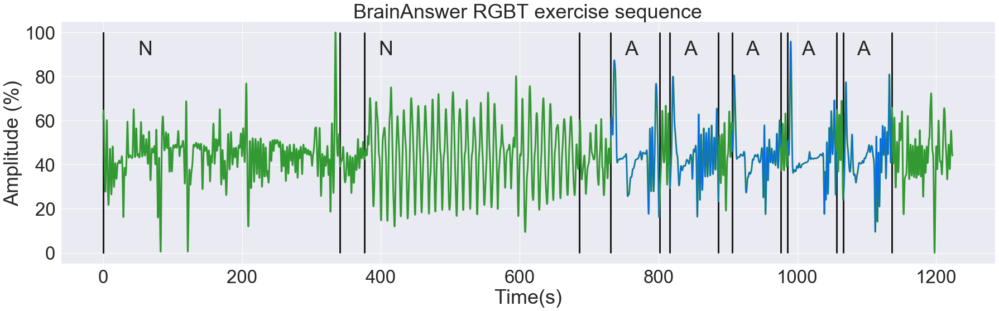

In [28]:
from scipy import signal
def normal(sg, minsg, maxsg):
    res = 100 * (sg - minsg) / (maxsg - minsg)
    return res

def find_extremes(sig, mode, th):
    indexes, values = bp.tools.find_extrema(sig, mode)
    ind, peaks = [], []
    for pk in range(len(values)):
        if abs(values[pk] - np.mean(sig)) > float(th):
            ind += [indexes[pk]]
            peaks += [values[pk]]
    return ind, peaks


def deep_breath(sig):
    #the signal of the first apnea is received. The deep breath is characterized by a
    #sudden increase, which corresponds to a high value of the positive derivative.
    #to find the deep breathe we use find extremes
    ind, peaks = find_extremes(sig, 'both', 0.3)
    if peaks == []:
        plt.plot(sig)
        plt.scatter(ind,peaks)
        plt.show()
    div1 = np.diff(peaks)
    deep_b = np.max(div1)
    if deep_b > 0:
        print('\ndeep breathe was found')
        deep_idx = int(np.where(div1 == deep_b)[0])
        res = [peaks[deep_idx], peaks[deep_idx+1]]
    else:
        print(peaks, div1)
        res = 0
    print(res)
    return res

marker_label = dict([(2, 'N'), (5, 'N'), (8, 'A'), (10, 'A'), (12, 'A'), (14, 'A'), (16, 'A')])
_label = dict([(0, 'N'), (1, 'N'), (2, 'A'), (3, 'A'), (4, 'A'), (5, 'A'), (6, 'A')])
import seaborn as sb
sb.set(font_scale=3)
user_labs = []
user_data = []
for bf in [15]:#range(len(bitalino_files)):
    labs = []
    data = []
    df = pd.DataFrame.from_csv(bitalino_files[bf], parse_dates=True, index_col=0, header=0,sep=';')

    resp = np.array(bp.tools.filter_signal(df.A1, ftype='butter', band='bandpass', order=2, frequency=[0.01,0.35],sampling_rate=1000.)[
                        'signal'])
    resp = normal(resp,np.min(resp),np.max(resp))
    list_markers = [[mk, marker] for mk, marker in enumerate(df.MARKER) if
                        marker != 0 and marker in marker_label.keys()]
    fig=plt.figure(figsize=(30,8))
    print(list_markers)
    plt.plot(np.arange(0,len(resp)/1000,0.001),resp, color ='#339933',linewidth=3)
    plt.vlines(np.array(list_markers[1:])*0.001,0,100,linewidth=3)
    plt.title('BrainAnswer RGBT exercise sequence')
    plt.xlabel('Time(s)')
    plt.ylabel('Amplitude (%)')
    arr = np.array(list_markers)[:,0]*0.001
    la = 0
    for o, lm in enumerate(arr[::2]):
        print(o, lm)
        init = list_markers[o*2][0]
        end = list_markers[o*2+1][0]
        if _label[la] == 'A':
            x_arr = np.arange(init*0.001,end*0.001, 0.001)
            if len(np.arange(init*0.001,end*0.001, 0.001)) != len(resp[init:end]):
                x_arr = x_arr[:-1]
            plt.plot(x_arr, resp[init:end], color='#0066ff')
            #plt.plot(resp[], color='#0066cc')
        plt.text(lm+20,90,_label[la])
        la+=1
    plt.savefig('exercise.eps', bbox_inches='tight', format='eps')
    plt.show()
    break
    deep = resp[list_markers[4][0]:list_markers[5][0]]
    xminmax = deep_breath(deep)

    for lm in range(0,len(list_markers),2):
        sig = resp[list_markers[lm][0]:list_markers[lm+1][0]]
        lab = marker_label[list_markers[lm][1]]
        
        for k in range(0,len(sig)-60000,60000):
            signl = sig[k:k+59999]
            aaa
            signl = signal.resample(normal(signl, np.min(signl), np.max(signl)),1000)
            labs += [lab]
            data += [signl]
            #plt.plot(signal)
#             plt.title(lab)
#             plt.show()            
    user_labs += [labs]
    user_data += [data]
            

        



In [6]:
import pickle
with open(r"user_labs", "wb") as output_file:
    pickle.dump(user_labs, output_file)

with open(r"user_data", "wb") as output_file:
    pickle.dump(user_data, output_file)

In [2]:
all_ap =[]
x_ann = pd.read_csv(r'pd_ann.csv', header=[0])

for ur in users:
    if 'x' not in ur:
        annot_s = wfdb.rdann(folder+os.sep+ur, extension='apn').symbol
        
    else:
        annots = x_ann[ur].values.tolist()[0]
        annot_s = [an for an in annots]

    all_ap += [annot_s] #let's ignore the last sample

resp_ap =[]
for ur in users_resp:
    
    annot_s = wfdb.rdann(folder+os.sep+ur, extension='apn').symbol

    resp_ap += [annot_s] #let's ignore the last sample
    
count_resp = np.array([[resp_ap[i].count('A'),resp_ap[i].count('N')] for i in range(len(resp_ap))])
pd_resp = pd.DataFrame([count_resp[:,0],count_resp[:,1]], index=['A','N'], columns=users_resp)
count_all = np.array([[all_ap[i].count('A'),all_ap[i].count('N')] for i in range(len(all_ap))])
pd_all = pd.DataFrame([count_all[:,0],count_all[:,1]], index=['A','N'], columns=users)

In [3]:
def get_signal_from_file(users_data, labels, resp=False, show=False):
    all_UR =[]
    new_labs = []
    for u,ur in enumerate(users_data):
        labs= [] 
        start=True
        print(u)
        pos = wfdb.rdann(folder+os.sep+ur, extension='apn').sample
        for an in np.arange(len(pos)-1):
            label = labels[u][an]
            san = pos[an]
            wfdb.rdann(folder+os.sep+ur, extension='apn').sample[-1]
            try:
                record_small = wfdb.rdrecord(folder + os.sep + ur, sampfrom=san, sampto=san+5999)  
            except:
                print(san+5999, wfdb.rdann(folder+os.sep+ur, extension='apn').sample[-1])

            if resp:
                X = pd.DataFrame(record_small.p_signal, columns=['ecg','respC','respA','respN','sp02'])
                if show:
                    plt.plot(X['ecg'], label=labels[u][an])
                    plt.plot(X['respN'])
                    plt.plot(np.arange(0,6000,6),all_data[u][an])
                    plt.legend()
                    plt.show()
            else:
                X = pd.DataFrame(record_small.p_signal, columns=['ecg'])
                if show:
                    plt.plot(record_small.p_signal)
                    plt.legend()
                    plt.show()
            
            if np.max(abs(X['ecg'])) >=0.1:
                if start:
                    ur_X = [X]
                    start=False
                else:
                    ur_X += [X]
                    
                labs += [labels[u][an]]   
            else:
                print(str([u,an]) + '  -- Removing zero signal')
                
        all_UR += [ur_X]
        new_labs += [labs]

    for al in range(len(all_UR)):
        if (len(new_labs[al]) == len(all_UR[al])):
            True
        else:
            print('For acquisition ' + str(users_data[al]) +' Length of labels ' + str(len(new_labs[al])) 
                  + ' is different from length of signal ' + str(len(all_UR[al])))         
    return all_UR, new_labs 

#all_UR,all_ap = get_signal_from_file(users)

resp_UR,resp_ap = get_signal_from_file(users_resp, resp_ap, resp=True, show=False)

0
1
2
3
4
5
[5, 0]  -- Removing zero signal
[5, 1]  -- Removing zero signal
[5, 2]  -- Removing zero signal
[5, 3]  -- Removing zero signal
[5, 6]  -- Removing zero signal
[5, 7]  -- Removing zero signal
6
[6, 0]  -- Removing zero signal
[6, 2]  -- Removing zero signal
[6, 3]  -- Removing zero signal
[6, 5]  -- Removing zero signal
[6, 6]  -- Removing zero signal
[6, 7]  -- Removing zero signal
[6, 8]  -- Removing zero signal
7


In [5]:
#all_UR = pickle.load(open('ApneaECG' + '_X', 'rb'))
#all_ap = pickle.load(open('ApneaECG' + '_Y', 'rb'))

reload(bp)

def normal(sg, minsg=None, maxsg=None):
    if minsg is None and maxsg is  None:
        minsg = np.min(sg)
        maxsg = np.max(sg)
    return 2 * (sg - minsg) / (maxsg - minsg) - 1

from scipy import signal
from scipy.stats import pearsonr
def extract_signal(values, lab):
    if 'resp' in lab:
        _filt = np.array(bp.tools.filter_signal(values, ftype='butter', band='bandpass', order=2, frequency=[0.01,0.35],sampling_rate=100.)[
                        'signal'])
        _filt = signal.resample(_filt,1000)
        #_filt = np.array(bp.signals.resp.resp(values,sampling_rate=100.,show=False)['resp_rate'])
    
    return _filt

def data_collection(all_UR, all_ap, lab='respC',indep=True):
    if indep:
        for ur in range(len(all_UR)):

            for xi in range(len(all_UR[ur])):

                if all_ap[ur][xi] == 'N':

                    resp = all_UR[ur][xi][lab].values
                    resp_filt = extract_signal(resp, lab)
                    if xi == 0:
                        X = resp_filt
                    else:
                        X = np.vstack((X,resp_filt))
            if ur == 0:
                data = X
            else:
                data = np.vstack((data,X))
    else:
        for ur in range(len(all_UR)):

            for xi in range(len(all_UR[ur])):

                #if all_ap[ur][xi] == 'N':

                resp = all_UR[ur][xi][lab].values
                resp_filt = extract_signal(resp, lab)
                #resp_filt_filt = bp.resp.resp(resp, sampling_rate=100.,show=False)['filtered']

                #resp_filt = signal.resample(resp_filt,1000)
#                 resp_ = signal.resample(all_UR[ur][xi]['respN'].values,1000)
#                 plt.plot(resp_filt,label=all_ap[ur][xi])
#                 corr = pearsonr(resp_filt,resp_)
#                 plt.plot(resp_,label=corr)
#                 plt.legend()
#                 plt.show()
                if resp_filt is not None:
                    if xi == 0:
                        X = resp_filt
                        len_X = len(X) 
                        labs = [all_ap[ur][xi]]
                    else:
                        
                        if len_X != len(resp_filt):
                            min_len = np.min([len_X,len(resp_filt)])

                            if min_len > 5500:
                                X = X.T[:min_len].T
                                X = np.vstack((X,resp_filt[:min_len]))
                                len_X = len(X[0])    
                                labs += [all_ap[ur][xi]]
                        else:
                            X = np.vstack((X,resp_filt))
                            labs += [all_ap[ur][xi]]
            if len(X) != len(labs):
                print('For user ' + str(ur) + ' Length of X ' + str(len(X)) + ' is different than length of Labels ' +str(len(labs)))
                #all_ap[ur] = all_ap[ur][:len(X)]
            if len(X.shape) > 1:
                if ur == 0:
                    data = [X]
                    new_lab = [labs]
                else:
                    data += [X]
                    new_lab += [labs]
            else:
                print('User ' +str(ur) + ' will be left out')
        np.array(data).shape
        with open(r"RespN_Y", "wb") as output_file:
            pickle.dump(new_lab, output_file)
    return np.array(data)

data_resp =  data_collection(resp_UR,resp_ap, lab='respN', indep=False) 


In [6]:

# _UR = data_resp
#_ap = pickle.load(open('RespN_Y','rb'))
_UR = user_data
_ap = user_labs

# 2 autoencoders

In [7]:
import random
from sklearn.model_selection import train_test_split
import multiAE_creation as mc
def part_balance(list_vecs, list_lab):
    train = []
    lab = []
    for v, vec in enumerate(list_vecs):

        num = list_lab[v].count('A')
        if num != 0:
            sel = random.choices(vec[:-num], k=num)
            tr = np.concatenate([sel, vec[-num:]])
            ba = ['N']*num + ['A']*num

            train += [tr]
            lab += [ba]

            if len(tr)!=len(ba):
                aaaa
    return train, lab

def create_autoencoder(x_train,y_train, x_test, y_test, label, loss, 
                       activ = 'tanh', opt = 'adam', nodes = [500,250,50],epochs=100):
    mc.autoencoder_params(nodes[-1], 1000, nodes, activ, opt,  loss,
                          x_train,y_train, x_test, y_test,label, epochs)

def separate_classes(vecs,labs, classes=['A','N']):
    #take the whole set and separate classes.
    new_vec, new_labs = [],[]
    for cl in classes:
        
        cl_index = [i for i in range(len(labs)) if labs[i] == cl]
        vec_ = np.array(vecs)[cl_index]
        lab_ = np.array(labs)[cl_index]
        new_vec += [vec_]
        new_labs += [lab_]
    return new_vec, new_labs

# for user in range(len(_UR)):
    
#     training_set_x = list(_UR)
#     del(training_set_x[user])
#     training_set_y = _ap[:]
#     del(training_set_y[user])
#     training_set_x = np.concatenate(training_set_x, axis=0)
#     print(np.array(training_set_x).shape)
#     training_set_y = np.concatenate(training_set_y)
    
#     train, y_train = separate_classes(training_set_x, training_set_y)
    
#     ap_train = train[0]
#     n_train = train[1]
#     #training_set_y = np.array([1 if yt == 'N' else 0 for yt in training_set_y])
    
#     ap_train, ap_test, ap_ytrain, ap_ytest = \
#         train_test_split(ap_train, y_train[0], test_size=.4, random_state=42)
#     n_train, n_test, n_ytrain, n_ytest = \
#         train_test_split(n_train, y_train[1], test_size=.4, random_state=42)
#     #print('This train contains ' + str(list(ae_ytrain).count('A')) + ' Apneas and ' + str(list(ae_ytrain).count('N')) + ' Normal events')
    
#     loss = 'cosine_proximity'
#     activ='tanh'
#     opt='adam'
    
#     nodes = [500,250,50]
    
    
#     create_autoencoder(n_train, n_train, n_test, n_test, 'RN', loss, activ, opt, nodes = nodes, epochs=50)
#     #create_autoencoder(n_train, n_train, n_test, n_test, 'RC', loss, activ, opt, nodes = nodes, epochs=50)
    
#     encoder = pickle.load(open('RN_encoder', 'rb'))
#     decoder = pickle.load(open('RN_decoder', 'rb'))
    
#     testing_set_x = _UR[user]
#     testing_set_y = _ap[user]
    
#     enc = encoder.predict(testing_set_x)
#     dec = decoder.predict(enc)
    
#     for d in range(len(dec)):
        
#         plt.plot(dec[d], label=testing_set_y[d])
#         corr = [pearsonr(dec[d][i:i+100],testing_set_x[d][i:i+100])[0] for i in range(0,len(dec[d]),100)]
#         plt.title(corr)
#         plt.plot(testing_set_x[d], label='input')
#         plt.legend()
#         plt.show()
        

Using TensorFlow backend.


# Autocorrelation Autoencoder

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 8s 32ms/step - loss: -0.1270 - val_loss: -0.3877
Epoch 2/50
258/258 [==============================] - 0s 843us/step - loss: -0.4700 - val_loss: -0.5390
Epoch 3/50
258/258 [==============================] - 0s 839us/step - loss: -0.5939 - val_loss: -0.5958
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6550 - val_loss: -0.6324
Epoch 5/50
258/258 [==============================] - 0s 777us/step - loss: -0.6974 - val_loss: -0.6659
Epoch 6/50
258/258 [==============================] - 0s 785us/step - loss: -0.7347 - val_loss: -0.6940
Epoch 7/50
258/258 [==============================] - 0s 820us/step - loss: -0.7661 - val_loss: -0.7182
Epoch 8/50
258/258 [==============================] - 0s 777us/step - loss: -0.7

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


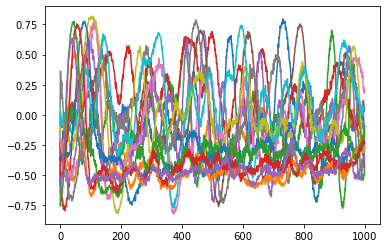

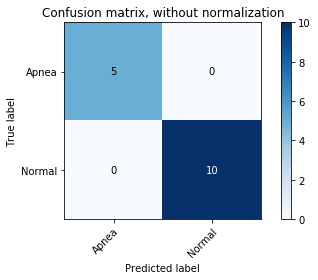

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 9s 34ms/step - loss: -0.1127 - val_loss: -0.3944
Epoch 2/50
258/258 [==============================] - 0s 765us/step - loss: -0.4603 - val_loss: -0.5315
Epoch 3/50
258/258 [==============================] - 0s 808us/step - loss: -0.5761 - val_loss: -0.5833
Epoch 4/50
258/258 [==============================] - 0s 773us/step - loss: -0.6309 - val_loss: -0.6178
Epoch 5/50
258/258 [==============================] - 0s 769us/step - loss: -0.6746 - val_loss: -0.6497
Epoch 6/50
258/258 [==============================] - 0s 769us/step - loss: -0.7128 - val_loss: -0.6786
Epoch 7/50
258/258 [==============================] - 0s 835us/step - loss: -0.7455 - val_loss: -0.7031
Epoch 8/50
258/258 [==============================] - 0s 959us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.5333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [7 3]]


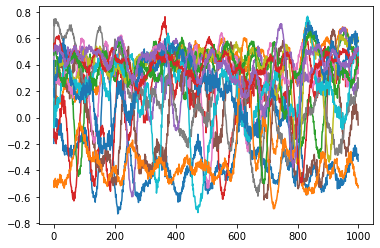

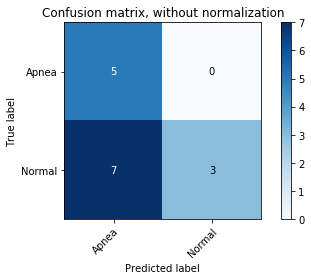

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 8s 32ms/step - loss: -0.1281 - val_loss: -0.3998
Epoch 2/50
258/258 [==============================] - 0s 835us/step - loss: -0.4761 - val_loss: -0.5452
Epoch 3/50
258/258 [==============================] - 0s 796us/step - loss: -0.5951 - val_loss: -0.5984
Epoch 4/50
258/258 [==============================] - 0s 785us/step - loss: -0.6499 - val_loss: -0.6313
Epoch 5/50
258/258 [==============================] - 0s 777us/step - loss: -0.6923 - val_loss: -0.6611
Epoch 6/50
258/258 [==============================] - 0s 769us/step - loss: -0.7264 - val_loss: -0.6895
Epoch 7/50
258/258 [==============================] - 0s 816us/step - loss: -0.7579 - val_loss: -0.7133
Epoch 8/50
258/258 [==============================] - 0s 816us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.6666666666666666%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [5 5]]


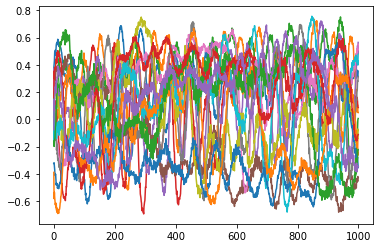

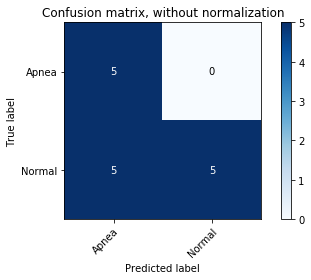

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 8s 33ms/step - loss: -0.1169 - val_loss: -0.3810
Epoch 2/50
258/258 [==============================] - 0s 835us/step - loss: -0.4576 - val_loss: -0.5320
Epoch 3/50
258/258 [==============================] - 0s 781us/step - loss: -0.5797 - val_loss: -0.5882
Epoch 4/50
258/258 [==============================] - 0s 808us/step - loss: -0.6363 - val_loss: -0.6239
Epoch 5/50
258/258 [==============================] - 0s 789us/step - loss: -0.6788 - val_loss: -0.6575
Epoch 6/50
258/258 [==============================] - 0s 881us/step - loss: -0.7187 - val_loss: -0.6860
Epoch 7/50
258/258 [==============================] - 0s 777us/step - loss: -0.7499 - val_loss: -0.7112
Epoch 8/50
258/258 [==============================] - 0s 796us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[ 4  1]
 [ 0 10]]


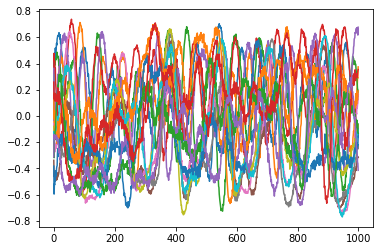

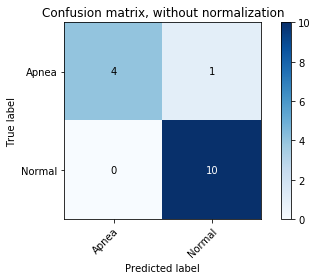

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 8s 33ms/step - loss: -0.1313 - val_loss: -0.4005
Epoch 2/50
258/258 [==============================] - 0s 827us/step - loss: -0.4694 - val_loss: -0.5373
Epoch 3/50
258/258 [==============================] - 0s 800us/step - loss: -0.5877 - val_loss: -0.5941
Epoch 4/50
258/258 [==============================] - 0s 854us/step - loss: -0.6466 - val_loss: -0.6301
Epoch 5/50
258/258 [==============================] - 0s 843us/step - loss: -0.6935 - val_loss: -0.6596
Epoch 6/50
258/258 [==============================] - 0s 804us/step - loss: -0.7306 - val_loss: -0.6886
Epoch 7/50
258/258 [==============================] - 0s 820us/step - loss: -0.7630 - val_loss: -0.7126
Epoch 8/50
258/258 [==============================] - 0s 831us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.4666666666666667%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [8 2]]


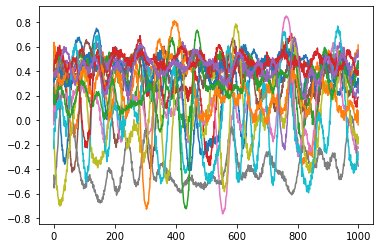

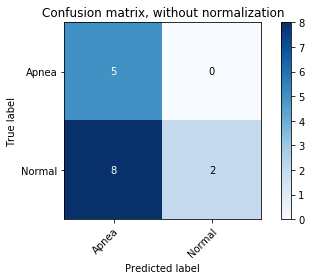

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 8s 32ms/step - loss: -0.1387 - val_loss: -0.4092
Epoch 2/50
258/258 [==============================] - 0s 816us/step - loss: -0.4769 - val_loss: -0.5438
Epoch 3/50
258/258 [==============================] - 0s 831us/step - loss: -0.5925 - val_loss: -0.5993
Epoch 4/50
258/258 [==============================] - 0s 792us/step - loss: -0.6527 - val_loss: -0.6370
Epoch 5/50
258/258 [==============================] - 0s 777us/step - loss: -0.6983 - val_loss: -0.6701
Epoch 6/50
258/258 [==============================] - 0s 808us/step - loss: -0.7379 - val_loss: -0.6987
Epoch 7/50
258/258 [==============================] - 0s 823us/step - loss: -0.7701 - val_loss: -0.7217
Epoch 8/50
258/258 [==============================] - 0s 820us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


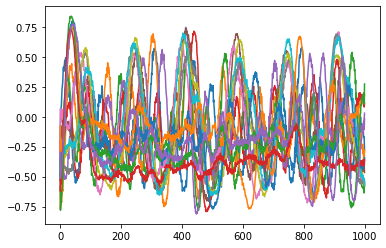

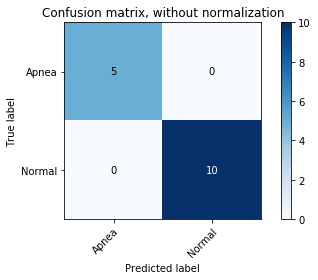

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 9s 33ms/step - loss: -0.1141 - val_loss: -0.3968
Epoch 2/50
258/258 [==============================] - 0s 816us/step - loss: -0.4671 - val_loss: -0.5435
Epoch 3/50
258/258 [==============================] - 0s 831us/step - loss: -0.5885 - val_loss: -0.5991
Epoch 4/50
258/258 [==============================] - 0s 850us/step - loss: -0.6455 - val_loss: -0.6320
Epoch 5/50
258/258 [==============================] - 0s 812us/step - loss: -0.6869 - val_loss: -0.6652
Epoch 6/50
258/258 [==============================] - 0s 831us/step - loss: -0.7258 - val_loss: -0.6917
Epoch 7/50
258/258 [==============================] - 0s 975us/step - loss: -0.7565 - val_loss: -0.7156
Epoch 8/50
258/258 [==============================] - 0s 877us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.8666666666666667%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [2 8]]


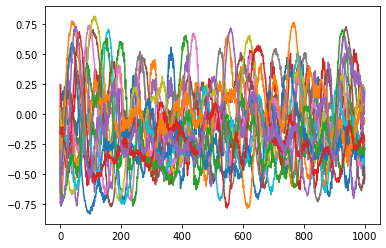

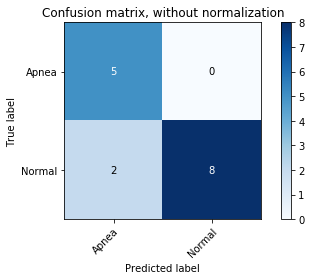

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 9s 34ms/step - loss: -0.1539 - val_loss: -0.4247
Epoch 2/50
258/258 [==============================] - 0s 916us/step - loss: -0.4914 - val_loss: -0.5439
Epoch 3/50
258/258 [==============================] - 0s 908us/step - loss: -0.5909 - val_loss: -0.5936
Epoch 4/50
258/258 [==============================] - 0s 862us/step - loss: -0.6469 - val_loss: -0.6355
Epoch 5/50
258/258 [==============================] - 0s 881us/step - loss: -0.6935 - val_loss: -0.6693
Epoch 6/50
258/258 [==============================] - 0s 862us/step - loss: -0.7311 - val_loss: -0.6980
Epoch 7/50
258/258 [==============================] - 0s 904us/step - loss: -0.7632 - val_loss: -0.7212
Epoch 8/50
258/258 [==============================] - 0s 854us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


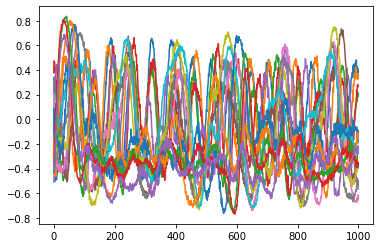

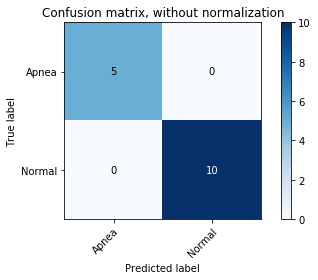

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 9s 35ms/step - loss: -0.1473 - val_loss: -0.4133
Epoch 2/50
258/258 [==============================] - 0s 858us/step - loss: -0.4851 - val_loss: -0.5362
Epoch 3/50
258/258 [==============================] - 0s 850us/step - loss: -0.5875 - val_loss: -0.5927
Epoch 4/50
258/258 [==============================] - 0s 862us/step - loss: -0.6478 - val_loss: -0.6370
Epoch 5/50
258/258 [==============================] - 0s 839us/step - loss: -0.6942 - val_loss: -0.6741
Epoch 6/50
258/258 [==============================] - 0s 881us/step - loss: -0.7335 - val_loss: -0.7034
Epoch 7/50
258/258 [==============================] - 0s 897us/step - loss: -0.7665 - val_loss: -0.7274
Epoch 8/50
258/258 [==============================] - 0s 889us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.8%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [3 7]]


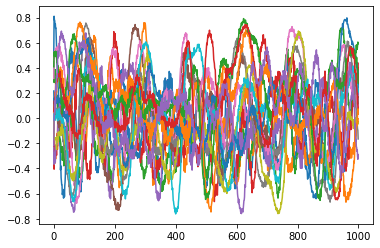

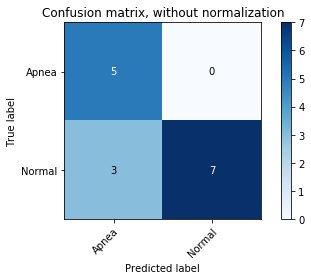

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 9s 36ms/step - loss: -0.1168 - val_loss: -0.3901
Epoch 2/50
258/258 [==============================] - 0s 893us/step - loss: -0.4665 - val_loss: -0.5427
Epoch 3/50
258/258 [==============================] - 0s 866us/step - loss: -0.5899 - val_loss: -0.6015
Epoch 4/50
258/258 [==============================] - 0s 908us/step - loss: -0.6502 - val_loss: -0.6393
Epoch 5/50
258/258 [==============================] - 0s 943us/step - loss: -0.6940 - val_loss: -0.6728
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7324 - val_loss: -0.7014
Epoch 7/50
258/258 [==============================] - 0s 866us/step - loss: -0.7645 - val_loss: -0.7239
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.790

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.8666666666666667%
-----------------------------------------
Confusion matrix, without normalization
[[4 1]
 [1 9]]


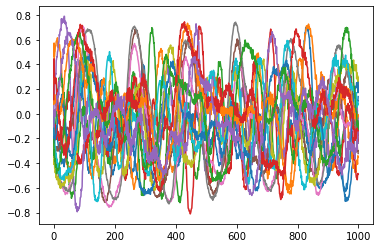

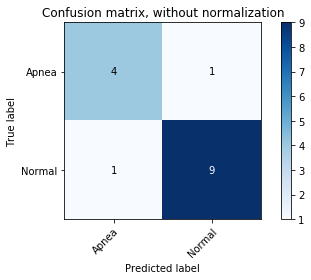

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 9s 35ms/step - loss: -0.1392 - val_loss: -0.4200
Epoch 2/50
258/258 [==============================] - 0s 928us/step - loss: -0.4827 - val_loss: -0.5412
Epoch 3/50
258/258 [==============================] - 0s 897us/step - loss: -0.5872 - val_loss: -0.5966
Epoch 4/50
258/258 [==============================] - 0s 879us/step - loss: -0.6453 - val_loss: -0.6378
Epoch 5/50
258/258 [==============================] - 0s 939us/step - loss: -0.6898 - val_loss: -0.6704
Epoch 6/50
258/258 [==============================] - 0s 905us/step - loss: -0.7267 - val_loss: -0.6978
Epoch 7/50
258/258 [==============================] - 0s 862us/step - loss: -0.7583 - val_loss: -0.7200
Epoch 8/50
258/258 [==============================] - 0s 866us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


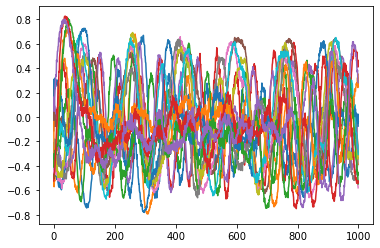

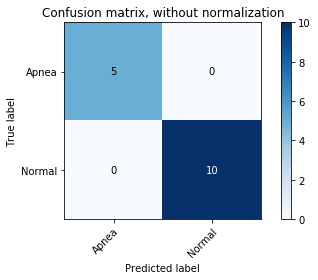

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 9s 35ms/step - loss: -0.1187 - val_loss: -0.3856
Epoch 2/50
258/258 [==============================] - 0s 862us/step - loss: -0.4638 - val_loss: -0.5410
Epoch 3/50
258/258 [==============================] - 0s 885us/step - loss: -0.5871 - val_loss: -0.5983
Epoch 4/50
258/258 [==============================] - 0s 889us/step - loss: -0.6444 - val_loss: -0.6366
Epoch 5/50
258/258 [==============================] - 0s 827us/step - loss: -0.6908 - val_loss: -0.6701
Epoch 6/50
258/258 [==============================] - 0s 850us/step - loss: -0.7291 - val_loss: -0.6989
Epoch 7/50
258/258 [==============================] - 0s 862us/step - loss: -0.7621 - val_loss: -0.7207
Epoch 8/50
258/258 [==============================] - 0s 870us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[ 4  1]
 [ 0 10]]


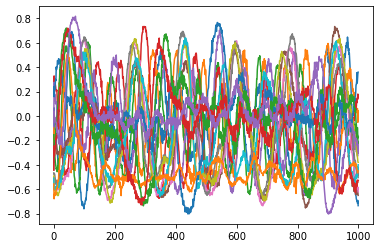

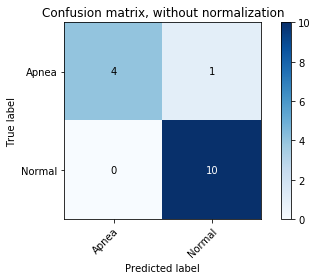

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 9s 35ms/step - loss: -0.1339 - val_loss: -0.4011
Epoch 2/50
258/258 [==============================] - 0s 858us/step - loss: -0.4723 - val_loss: -0.5441
Epoch 3/50
258/258 [==============================] - 0s 858us/step - loss: -0.5897 - val_loss: -0.6024
Epoch 4/50
258/258 [==============================] - 0s 916us/step - loss: -0.6508 - val_loss: -0.6392
Epoch 5/50
258/258 [==============================] - 0s 881us/step - loss: -0.6945 - val_loss: -0.6700
Epoch 6/50
258/258 [==============================] - 0s 916us/step - loss: -0.7308 - val_loss: -0.6980
Epoch 7/50
258/258 [==============================] - 0s 901us/step - loss: -0.7627 - val_loss: -0.7207
Epoch 8/50
258/258 [==============================] - 0s 908us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[ 4  1]
 [ 0 10]]


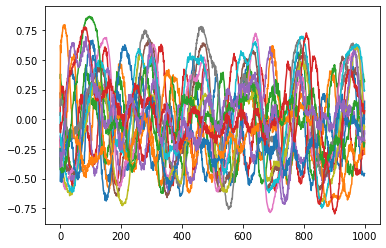

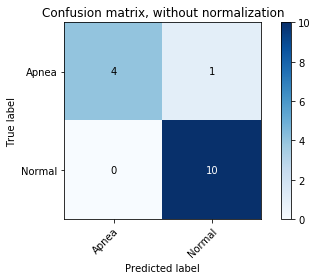

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 9s 35ms/step - loss: -0.1358 - val_loss: -0.4029
Epoch 2/50
258/258 [==============================] - 0s 905us/step - loss: -0.4738 - val_loss: -0.5336
Epoch 3/50
258/258 [==============================] - 0s 893us/step - loss: -0.5784 - val_loss: -0.5873
Epoch 4/50
258/258 [==============================] - 0s 877us/step - loss: -0.6345 - val_loss: -0.6313
Epoch 5/50
258/258 [==============================] - 0s 993us/step - loss: -0.6794 - val_loss: -0.6665
Epoch 6/50
258/258 [==============================] - 0s 959us/step - loss: -0.7184 - val_loss: -0.6945
Epoch 7/50
258/258 [==============================] - 0s 966us/step - loss: -0.7527 - val_loss: -0.7168
Epoch 8/50
258/258 [==============================] - 0s 935us/step - loss: -0

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[ 4  1]
 [ 0 10]]


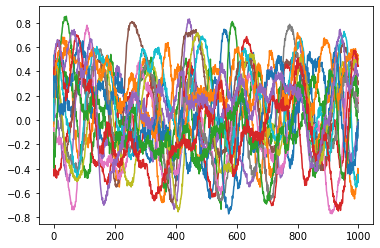

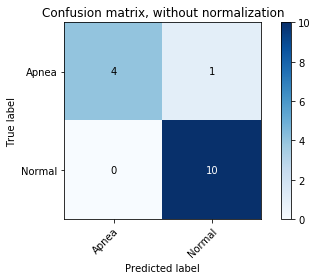

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 10s 37ms/step - loss: -0.1495 - val_loss: -0.4141
Epoch 2/50
258/258 [==============================] - 0s 929us/step - loss: -0.4868 - val_loss: -0.5353
Epoch 3/50
258/258 [==============================] - 0s 881us/step - loss: -0.5854 - val_loss: -0.5865
Epoch 4/50
258/258 [==============================] - 0s 916us/step - loss: -0.6410 - val_loss: -0.6253
Epoch 5/50
258/258 [==============================] - 0s 897us/step - loss: -0.6853 - val_loss: -0.6607
Epoch 6/50
258/258 [==============================] - 0s 901us/step - loss: -0.7244 - val_loss: -0.6903
Epoch 7/50
258/258 [==============================] - 0s 912us/step - loss: -0.7555 - val_loss: -0.7125
Epoch 8/50
258/258 [==============================] - 0s 898us/step - loss: -

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.8666666666666667%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [2 8]]


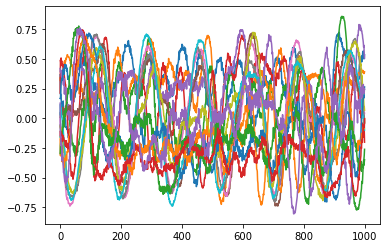

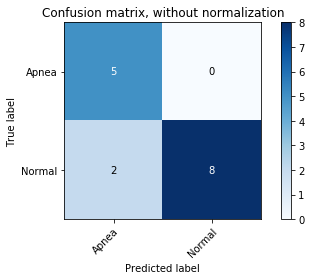

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 9s 36ms/step - loss: -0.1382 - val_loss: -0.3988
Epoch 2/50
258/258 [==============================] - 0s 987us/step - loss: -0.4758 - val_loss: -0.5390
Epoch 3/50
258/258 [==============================] - 0s 987us/step - loss: -0.5874 - val_loss: -0.5943
Epoch 4/50
258/258 [==============================] - 0s 974us/step - loss: -0.6441 - val_loss: -0.6343
Epoch 5/50
258/258 [==============================] - 0s 996us/step - loss: -0.6892 - val_loss: -0.6668
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7289 - val_loss: -0.6956
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7616 - val_loss: -0.7191
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7892 

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [0, 0, 1, 1, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.6%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [6 4]]


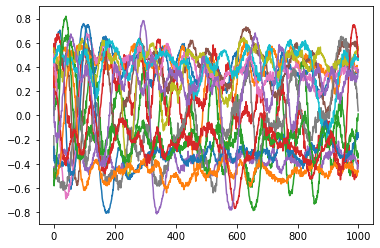

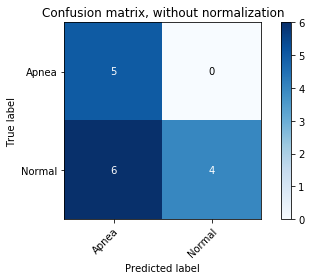

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 10s 37ms/step - loss: -0.1217 - val_loss: -0.3943
Epoch 2/50
258/258 [==============================] - 0s 896us/step - loss: -0.4708 - val_loss: -0.5304
Epoch 3/50
258/258 [==============================] - 0s 993us/step - loss: -0.5831 - val_loss: -0.5862
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6396 - val_loss: -0.6233
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6825 - val_loss: -0.6550
Epoch 6/50
258/258 [==============================] - 0s 995us/step - loss: -0.7210 - val_loss: -0.6829
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7522 - val_loss: -0.7065
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7802 -

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.8%
-----------------------------------------
Confusion matrix, without normalization
[[3 2]
 [1 9]]


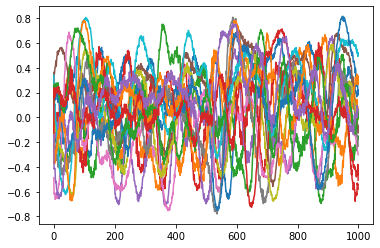

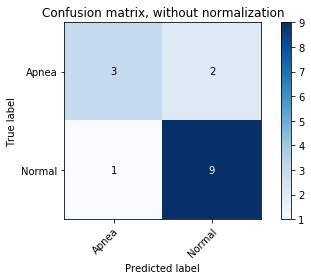

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 10s 37ms/step - loss: -0.1321 - val_loss: -0.3941
Epoch 2/50
258/258 [==============================] - 0s 934us/step - loss: -0.4744 - val_loss: -0.5282
Epoch 3/50
258/258 [==============================] - 0s 959us/step - loss: -0.5850 - val_loss: -0.5823
Epoch 4/50
258/258 [==============================] - 0s 955us/step - loss: -0.6434 - val_loss: -0.6277
Epoch 5/50
258/258 [==============================] - 0s 943us/step - loss: -0.6920 - val_loss: -0.6647
Epoch 6/50
258/258 [==============================] - 0s 970us/step - loss: -0.7328 - val_loss: -0.6974
Epoch 7/50
258/258 [==============================] - 0s 974us/step - loss: -0.7683 - val_loss: -0.7218
Epoch 8/50
258/258 [==============================] - 0s 974us/step - loss: -

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.7333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [4 6]]


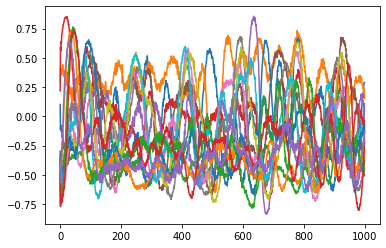

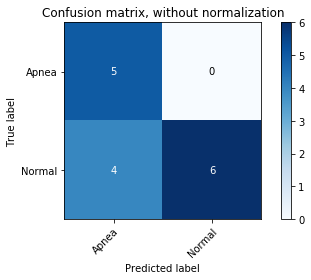

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 10s 39ms/step - loss: -0.1282 - val_loss: -0.3954
Epoch 2/50
258/258 [==============================] - 0s 988us/step - loss: -0.4702 - val_loss: -0.5353
Epoch 3/50
258/258 [==============================] - 0s 950us/step - loss: -0.5852 - val_loss: -0.5906
Epoch 4/50
258/258 [==============================] - 0s 978us/step - loss: -0.6428 - val_loss: -0.6304
Epoch 5/50
258/258 [==============================] - ETA: 0s - loss: -0.67 - 0s 992us/step - loss: -0.6869 - val_loss: -0.6635
Epoch 6/50
258/258 [==============================] - 0s 952us/step - loss: -0.7256 - val_loss: -0.6914
Epoch 7/50
258/258 [==============================] - 0s 978us/step - loss: -0.7579 - val_loss: -0.7134
Epoch 8/50
258/258 [==============================] -

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [1 9]]


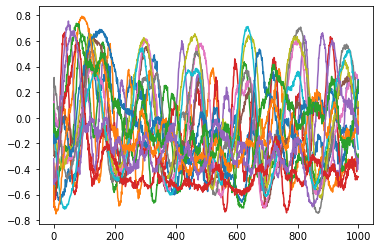

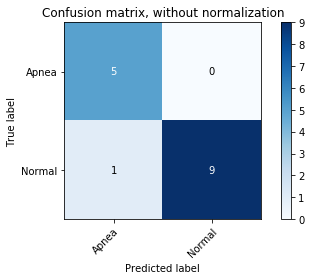

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 10s 39ms/step - loss: -0.1272 - val_loss: -0.3967
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4768 - val_loss: -0.5384
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5919 - val_loss: -0.5970
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6518 - val_loss: -0.6406
Epoch 5/50
258/258 [==============================] - 0s 992us/step - loss: -0.6989 - val_loss: -0.6752
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7366 - val_loss: -0.7037
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7691 - val_loss: -0.7284
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7970 - val

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.6666666666666666%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [5 5]]


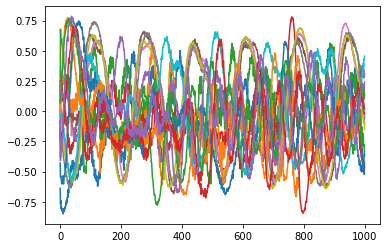

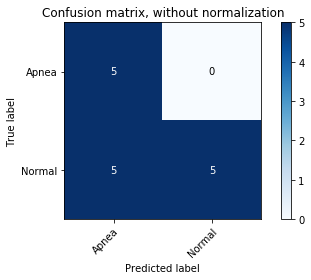

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 10s 39ms/step - loss: -0.1418 - val_loss: -0.4119
Epoch 2/50
258/258 [==============================] - 0s 954us/step - loss: -0.4899 - val_loss: -0.5386
Epoch 3/50
258/258 [==============================] - 0s 963us/step - loss: -0.5909 - val_loss: -0.5905
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6461 - val_loss: -0.6314
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6917 - val_loss: -0.6651
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7303 - val_loss: -0.6942
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7626 - val_loss: -0.7182
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7893 - v

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


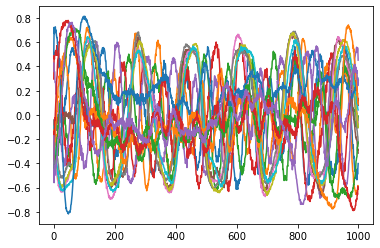

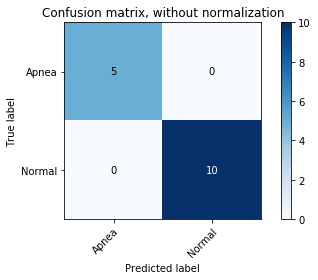

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 10s 40ms/step - loss: -0.1243 - val_loss: -0.3882
Epoch 2/50
258/258 [==============================] - 0s 947us/step - loss: -0.4673 - val_loss: -0.5249
Epoch 3/50
258/258 [==============================] - 0s 947us/step - loss: -0.5769 - val_loss: -0.5785
Epoch 4/50
258/258 [==============================] - 0s 955us/step - loss: -0.6340 - val_loss: -0.6238
Epoch 5/50
258/258 [==============================] - 0s 982us/step - loss: -0.6812 - val_loss: -0.6591
Epoch 6/50
258/258 [==============================] - 0s 982us/step - loss: -0.7199 - val_loss: -0.6913
Epoch 7/50
258/258 [==============================] - 0s 998us/step - loss: -0.7552 - val_loss: -0.7161
Epoch 8/50
258/258 [==============================] - 0s 970us/step - loss: -

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


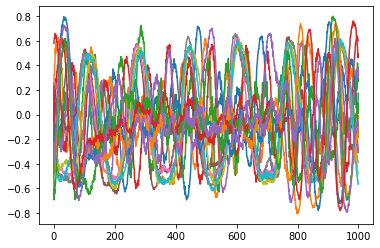

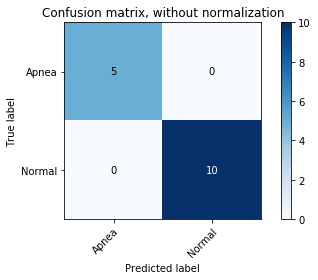

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 10s 40ms/step - loss: -0.1357 - val_loss: -0.3943
Epoch 2/50
258/258 [==============================] - 0s 986us/step - loss: -0.4741 - val_loss: -0.5217
Epoch 3/50
258/258 [==============================] - 0s 974us/step - loss: -0.5780 - val_loss: -0.5703
Epoch 4/50
258/258 [==============================] - 0s 951us/step - loss: -0.6294 - val_loss: -0.6102
Epoch 5/50
258/258 [==============================] - 0s 952us/step - loss: -0.6747 - val_loss: -0.6456
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7118 - val_loss: -0.6768
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7457 - val_loss: -0.7021
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7727

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [1 9]]


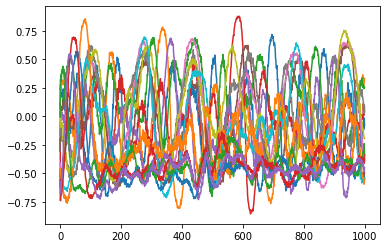

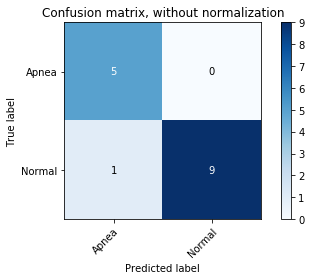

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 11s 41ms/step - loss: -0.1529 - val_loss: -0.4044
Epoch 2/50
258/258 [==============================] - 0s 939us/step - loss: -0.4810 - val_loss: -0.5265
Epoch 3/50
258/258 [==============================] - 0s 955us/step - loss: -0.5820 - val_loss: -0.5785
Epoch 4/50
258/258 [==============================] - 0s 951us/step - loss: -0.6385 - val_loss: -0.6252
Epoch 5/50
258/258 [==============================] - 0s 951us/step - loss: -0.6885 - val_loss: -0.6624
Epoch 6/50
258/258 [==============================] - 0s 928us/step - loss: -0.7285 - val_loss: -0.6949
Epoch 7/50
258/258 [==============================] - 0s 943us/step - loss: -0.7641 - val_loss: -0.7206
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [1 9]]


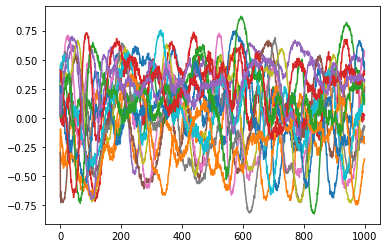

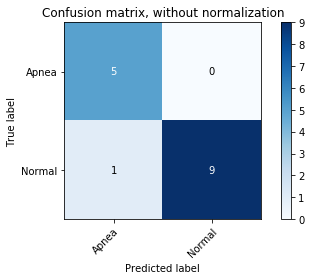

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 10s 41ms/step - loss: -0.1488 - val_loss: -0.4185
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4916 - val_loss: -0.5402
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5915 - val_loss: -0.5907
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6449 - val_loss: -0.6273
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6892 - val_loss: -0.6644
Epoch 6/50
258/258 [==============================] - 0s 997us/step - loss: -0.7270 - val_loss: -0.6936
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7580 - val_loss: -0.7170
Epoch 8/50
258/258 [==============================] - 0s 993us/step - loss: -0.7851 - v

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


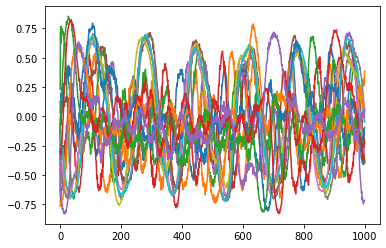

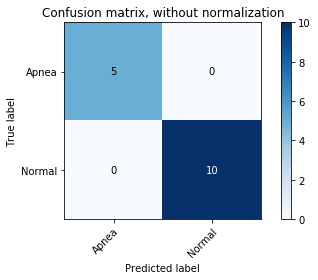

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 12s 47ms/step - loss: -0.1186 - val_loss: -0.3834
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4649 - val_loss: -0.5289
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5810 - val_loss: -0.5874
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6413 - val_loss: -0.6292
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6889 - val_loss: -0.6646
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7260 - val_loss: -0.6944
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7568 - val_loss: -0.7184
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7836 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


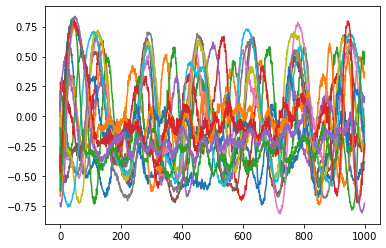

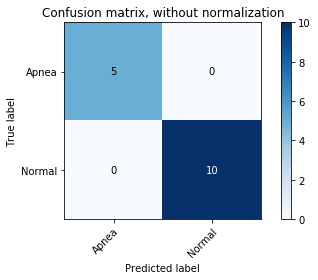

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 12s 45ms/step - loss: -0.1368 - val_loss: -0.3998
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4816 - val_loss: -0.5383
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5953 - val_loss: -0.5928
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6533 - val_loss: -0.6358
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6994 - val_loss: -0.6695
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7379 - val_loss: -0.7010
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7699 - val_loss: -0.7252
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7967 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


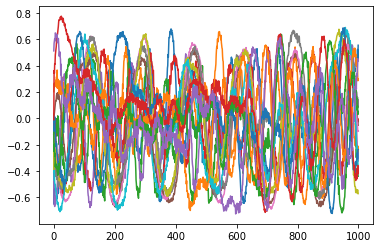

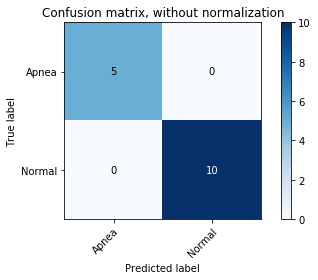

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 11s 43ms/step - loss: -0.1296 - val_loss: -0.4028
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4795 - val_loss: -0.5352
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5890 - val_loss: -0.5908
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6501 - val_loss: -0.6340
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6976 - val_loss: -0.6689
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7369 - val_loss: -0.6989
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7693 - val_loss: -0.7227
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7952 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1]
['SVM', 'Random Forest'] --- Accuracy: 0.6%
-----------------------------------------
Confusion matrix, without normalization
[[0 5]
 [1 9]]


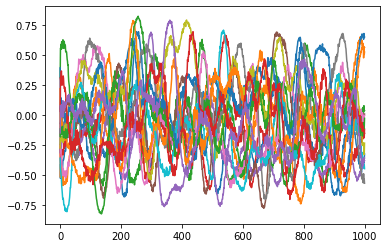

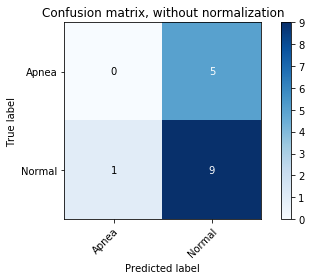

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 11s 43ms/step - loss: -0.1497 - val_loss: -0.4158
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4871 - val_loss: -0.5327
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5878 - val_loss: -0.5858
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6460 - val_loss: -0.6268
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6919 - val_loss: -0.6629
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7325 - val_loss: -0.6949
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7645 - val_loss: -0.7195
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7923 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [1 9]]


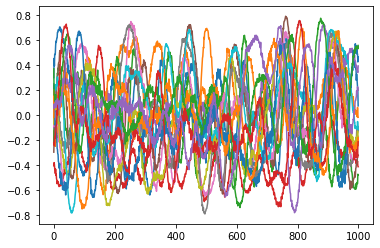

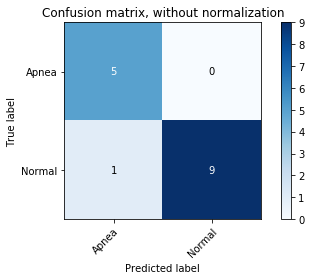

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 11s 44ms/step - loss: -0.1413 - val_loss: -0.4071
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4809 - val_loss: -0.5372
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5870 - val_loss: -0.5900
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6429 - val_loss: -0.6329
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6868 - val_loss: -0.6651
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7237 - val_loss: -0.6930
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7550 - val_loss: -0.7158
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7814 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


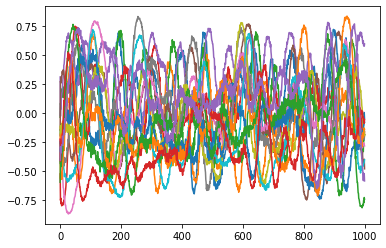

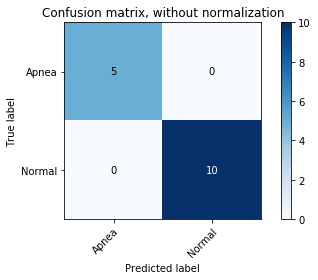

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 24s 92ms/step - loss: -0.1402 - val_loss: -0.4063
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4739 - val_loss: -0.5330
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5781 - val_loss: -0.5857
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6344 - val_loss: -0.6276
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6811 - val_loss: -0.6631
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7218 - val_loss: -0.6928
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7560 - val_loss: -0.7160
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7829 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.7333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [4 6]]


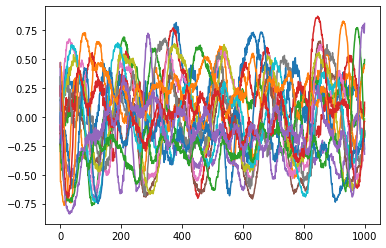

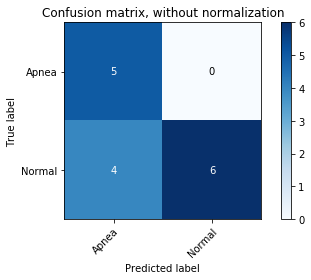

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 12s 45ms/step - loss: -0.1355 - val_loss: -0.4117
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4892 - val_loss: -0.5386
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5941 - val_loss: -0.5862
Epoch 4/50
258/258 [==============================] - 0s 995us/step - loss: -0.6456 - val_loss: -0.6248
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6865 - val_loss: -0.6558
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7210 - val_loss: -0.6848
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7515 - val_loss: -0.7063
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7762 - val

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


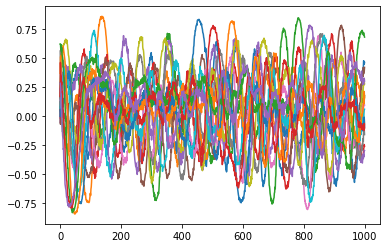

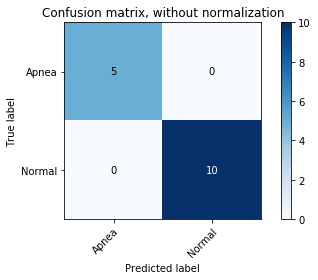

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 11s 44ms/step - loss: -0.1429 - val_loss: -0.3939
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4762 - val_loss: -0.5244
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5833 - val_loss: -0.5803
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6419 - val_loss: -0.6232
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6887 - val_loss: -0.6600
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7269 - val_loss: -0.6900
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7589 - val_loss: -0.7149
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7860 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [1 9]]


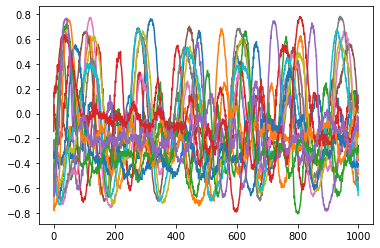

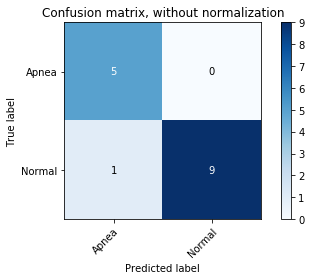

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 12s 45ms/step - loss: -0.1441 - val_loss: -0.3952
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4854 - val_loss: -0.5309
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5936 - val_loss: -0.5841
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6460 - val_loss: -0.6223
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6877 - val_loss: -0.6557
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7232 - val_loss: -0.6836
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7546 - val_loss: -0.7068
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7802 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[ 4  1]
 [ 0 10]]


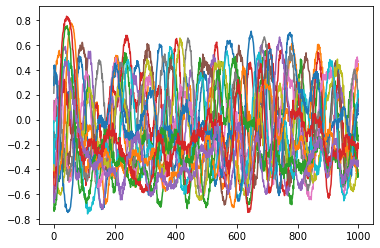

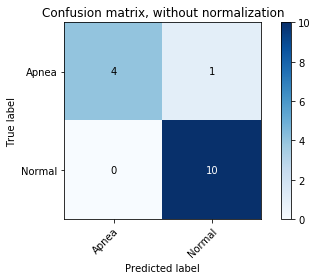

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 12s 47ms/step - loss: -0.1395 - val_loss: -0.4059
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4806 - val_loss: -0.5332
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5883 - val_loss: -0.5870
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6444 - val_loss: -0.6278
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6884 - val_loss: -0.6627
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7263 - val_loss: -0.6915
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7585 - val_loss: -0.7148
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7856 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


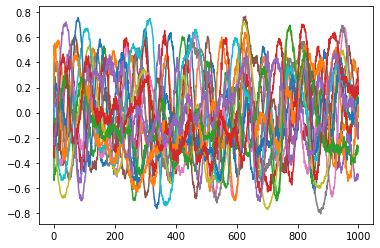

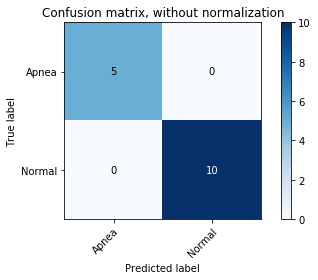

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 12s 45ms/step - loss: -0.1244 - val_loss: -0.3914
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4741 - val_loss: -0.5206
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5797 - val_loss: -0.5750
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6338 - val_loss: -0.6153
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6765 - val_loss: -0.6500
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7155 - val_loss: -0.6815
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7470 - val_loss: -0.7068
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7758 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[ 4  1]
 [ 0 10]]


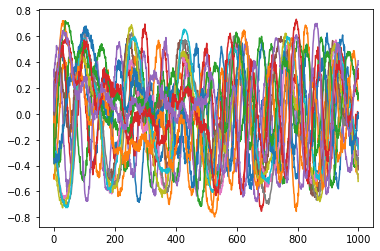

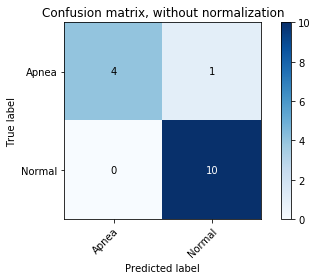

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 12s 46ms/step - loss: -0.1583 - val_loss: -0.4090
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4919 - val_loss: -0.5231
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5889 - val_loss: -0.5750
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6458 - val_loss: -0.6218
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6925 - val_loss: -0.6609
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7315 - val_loss: -0.6940
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7656 - val_loss: -0.7191
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7916 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


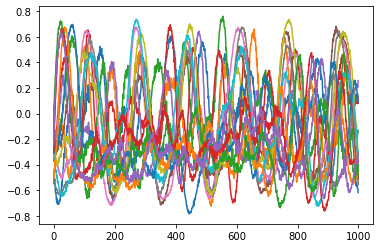

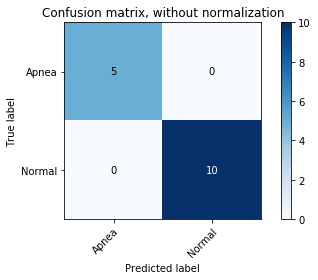

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 12s 48ms/step - loss: -0.1204 - val_loss: -0.3781
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4710 - val_loss: -0.5221
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5890 - val_loss: -0.5811
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6498 - val_loss: -0.6264
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6950 - val_loss: -0.6615
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7320 - val_loss: -0.6911
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7627 - val_loss: -0.7153
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7883 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.8%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [3 7]]


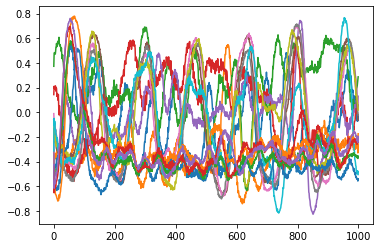

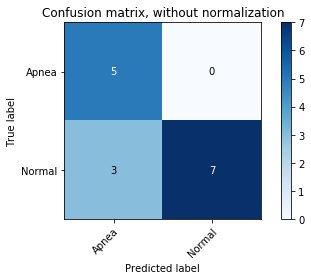

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 12s 48ms/step - loss: -0.1486 - val_loss: -0.4089
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4842 - val_loss: -0.5329
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5858 - val_loss: -0.5845
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6375 - val_loss: -0.6230
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6801 - val_loss: -0.6562
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7168 - val_loss: -0.6860
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7504 - val_loss: -0.7124
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7789 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.7333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [4 6]]


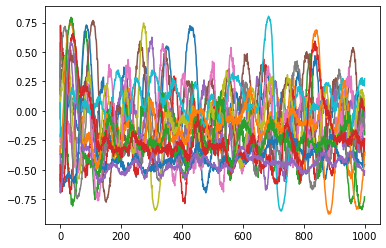

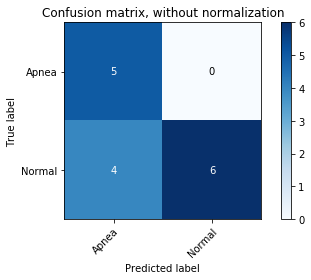

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 14s 53ms/step - loss: -0.1231 - val_loss: -0.3887
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4730 - val_loss: -0.5289
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5876 - val_loss: -0.5845
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6435 - val_loss: -0.6234
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6871 - val_loss: -0.6560
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7239 - val_loss: -0.6841
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7554 - val_loss: -0.7088
Epoch 8/50
258/258 [==============================] - 0s 2ms/step - loss: -0.7816 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.9333333333333333%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [1 9]]


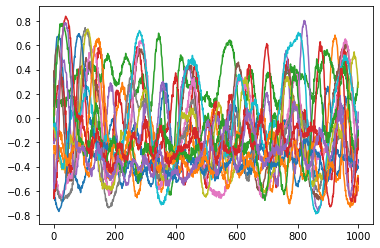

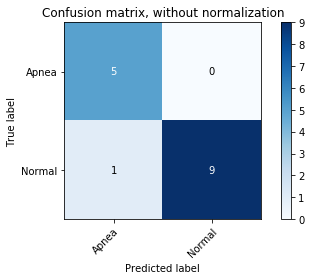

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 29s 113ms/step - loss: -0.1457 - val_loss: -0.3962
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4761 - val_loss: -0.5214
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5803 - val_loss: -0.5736
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6354 - val_loss: -0.6196
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6817 - val_loss: -0.6578
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7242 - val_loss: -0.6932
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7594 - val_loss: -0.7203
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7881 - val_

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.8666666666666667%
-----------------------------------------
Confusion matrix, without normalization
[[4 1]
 [1 9]]


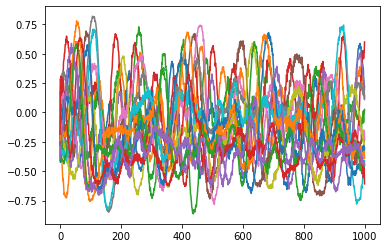

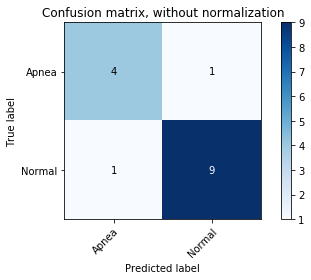

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 29s 113ms/step - loss: -0.1536 - val_loss: -0.4010
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4847 - val_loss: -0.5257
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5914 - val_loss: -0.5793
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6485 - val_loss: -0.6199
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6924 - val_loss: -0.6556
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7284 - val_loss: -0.6860
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7603 - val_loss: -0.7105
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7865 - val_

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.8666666666666667%
-----------------------------------------
Confusion matrix, without normalization
[[5 0]
 [2 8]]


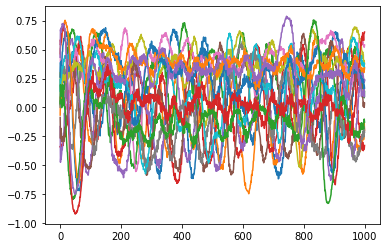

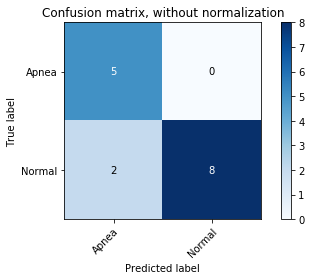

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 13s 49ms/step - loss: -0.1276 - val_loss: -0.3846
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4697 - val_loss: -0.5264
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5820 - val_loss: -0.5822
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6384 - val_loss: -0.6256
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6854 - val_loss: -0.6612
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7235 - val_loss: -0.6940
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7585 - val_loss: -0.7190
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7852 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 0, 0, 1, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 0.6%
-----------------------------------------
Confusion matrix, without normalization
[[4 1]
 [5 5]]


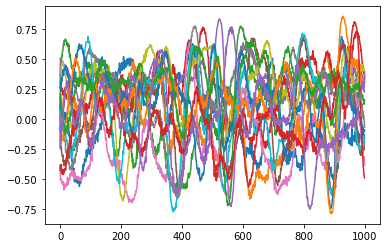

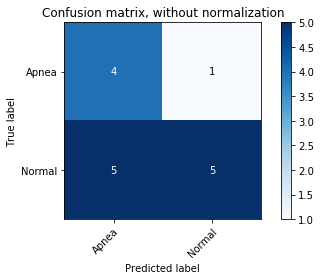

(645, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 258 samples, validate on 172 samples
Epoch 1/50
258/258 [==============================] - 13s 49ms/step - loss: -0.1455 - val_loss: -0.4126
Epoch 2/50
258/258 [==============================] - 0s 1ms/step - loss: -0.4891 - val_loss: -0.5323
Epoch 3/50
258/258 [==============================] - 0s 1ms/step - loss: -0.5897 - val_loss: -0.5839
Epoch 4/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6463 - val_loss: -0.6290
Epoch 5/50
258/258 [==============================] - 0s 1ms/step - loss: -0.6941 - val_loss: -0.6656
Epoch 6/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7327 - val_loss: -0.6986
Epoch 7/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7664 - val_loss: -0.7242
Epoch 8/50
258/258 [==============================] - 0s 1ms/step - loss: -0.7929 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0]
['SVM', 'Random Forest'] --- Accuracy: 1.0%
-----------------------------------------
Confusion matrix, without normalization
[[ 5  0]
 [ 0 10]]


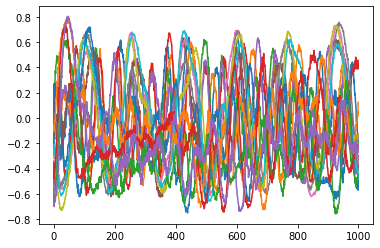

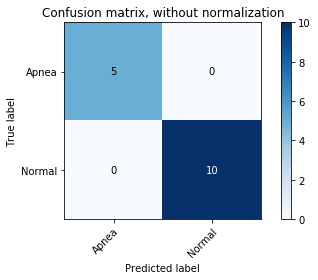

In [123]:

signal = _UR[:]
#all_corr = []
for user in range(len(signal)):
    
    training_set_x = list(signal)
    del(training_set_x[user])
    training_set_y = _ap[:]
    del(training_set_y[user])
    training_set_x = np.concatenate(training_set_x, axis=0)
    print(np.array(training_set_x).shape)
    training_set_y = np.concatenate(training_set_y)
    
    train, y_train = separate_classes(training_set_x, training_set_y)
    
    #ap_train = train[0]
    #n_train = train[1]
    #training_set_y = np.array([1 if yt == 'N' else 0 for yt in training_set_y])
    
    #ap_train, ap_test, ap_ytrain, ap_ytest = \
     #   train_test_split(ap_train, y_train[0], test_size=.4, random_state=42)
    n_train, n_test, n_ytrain, n_ytest = \
        train_test_split(train[1], y_train[1], test_size=.4, random_state=42)
    #print('This train contains ' + str(list(ae_ytrain).count('A')) + ' Apneas and ' + str(list(ae_ytrain).count('N')) + ' Normal events')
    
    loss = 'cosine_proximity'
    #loss = 'mean_squared_error'
    activ='tanh'
    opt='adam'
    
    nodes = [500,250,50]
    
    
    #create_autoencoder(ap_train, ap_train, ap_test, ap_test, 'RN', loss, activ, opt, nodes = nodes, epochs=50)
    create_autoencoder(n_train, n_train, n_test, n_test, 'RN', loss, activ, opt, nodes = nodes, epochs=50)
    
    encoder = pickle.load(open('RN_encoder', 'rb'))
    decoder = pickle.load(open('RN_decoder', 'rb'))
    
    testing_set_x = np.array(signal[user])
    testing_set_y = _ap[user]
    
    enc = encoder.predict(testing_set_x)
    dec = decoder.predict(enc)
    save_corr = []
    enc_train = encoder.predict(training_set_x)
    dec_train = decoder.predict(enc_train)
    train_cl,test_cl = [],[]
    y_train_new = []
    y_test_new = []
    for d in range(len(dec_train)):
        corr_train = [pearsonr(dec_train[d][i:i+100],training_set_x[d][i:i+100])[0] for i in range(0,len(dec_train[d]),100)]
        if np.isfinite(corr_train).all():
            train_cl += [corr_train]
            y_train_new += [training_set_y[d]]

    for d in range(len(dec)):
        
        plt.plot(dec[d])
        corr = [pearsonr(dec[d][i:i+100],testing_set_x[d][i:i+100])[0] for i in range(0,len(dec[d]),100)]
        
        if np.isfinite(corr).all():
            test_cl += [corr]
            y_test_new += [testing_set_y[d]]
        
    cl_score = []
    
    names = ["SVM", "Random Forest"] 
    
    classifiers = [SVC(gamma=2, C=1, probability=True),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1)]
    
    cl_score = fus_classifier(classifiers, names, train_cl,\
                                  test_cl, np.array(y_train_new), np.array(y_test_new), show=True)
    
        

In [122]:
svm = [93,40,67,100,40,100,67,100,80,93,100,100,100,100,87,67,80,73,73,53,\
       100,100,93,80,100,100,100,73,100,100,93,100,87,80,87,93,100,80,73,100]
rf = [93,47,67,87,47,100,80,100,67,93,93,93,93,100,93,60,80,73,80,60,100,\
      100,93,80,100,100,100,73,93,93,80,93,87,80,87,87,100,73,60,80,80,93,47,87]

print(np.mean(svm))
print(np.std(svm))

print(np.mean(rf))
print(np.std(rf))



86.3
16.459343850834394
83.45454545454545
15.173922824513692


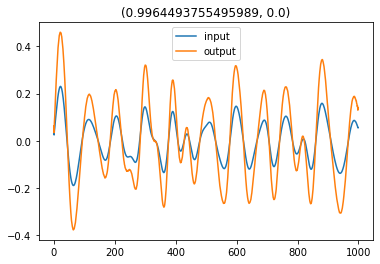

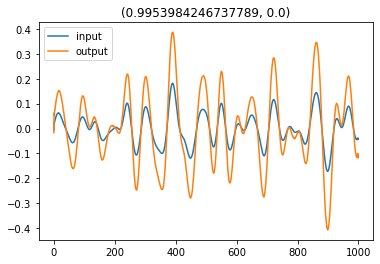

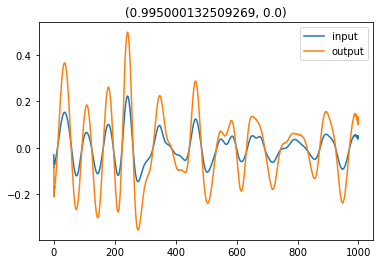

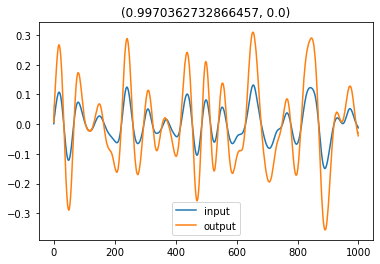

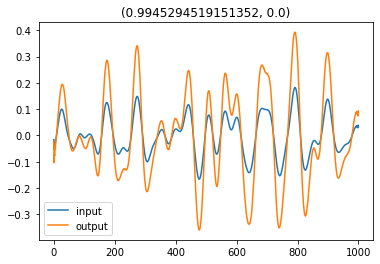

...

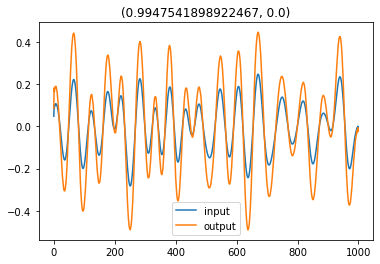

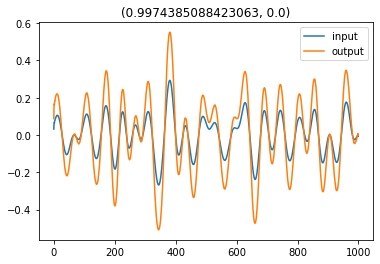

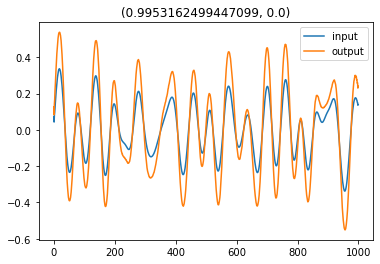

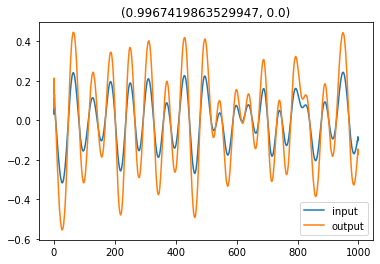

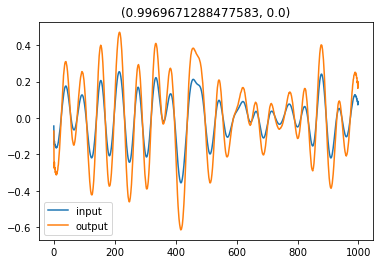

KeyboardInterrupt: 

In [39]:
from scipy.stats import pearsonr
for data in all_data:
    enc = encoder.predict(data)
    dec = decoder.predict(enc)


    for da in range(len(data)):
        
        plt.plot(data[da], label='input')
        plt.plot(dec[da], label='output')
        corr = pearsonr(data[da],dec[da])

        plt.title(str(corr))
        plt.legend()
        plt.show()

# Classification Phase

In [8]:
import numpy as np
import matplotlib.pyplot as plt

from sklearn import svm, datasets
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix
from sklearn.utils.multiclass import unique_labels


def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    #classes = classes[unique_labels(y_true, y_pred)]
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax


np.set_printoptions(precision=2)


In [63]:
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.svm import SVC, LinearSVC, NuSVC
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.model_selection import cross_val_score
import numpy as np
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix
# names = ["Decision Tree", "AdaBoost","GradBoost"]

# classifiers = [DecisionTreeClassifier(max_depth=5),
#     AdaBoostClassifier(),GradientBoostingClassifier()]
#names = ["GradBoost"]
#classifiers = [GradientBoostingClassifier()]
names = ["KNN", "SVM", "Decision Tree", "Random Forest", "Neural Net",\
        "Adaboost", "GradBoost", "Naive Bayes", "QDA"]
classifiers = [
    KNeighborsClassifier(3),
    SVC(gamma=2, C=1, probability=True),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1),
    MLPClassifier(alpha=1, max_iter=1000),
    AdaBoostClassifier(),
    GradientBoostingClassifier(),
    GaussianNB(),
    QuadraticDiscriminantAnalysis()]

#names = ["SVM", "Random Forest", "NeuralNet"]

def choose_classifier(data, labels):
    best=0
    cl_train, cl_test, cl_ytrain, cl_ytest = \
        train_test_split(data, labels, test_size=.4, random_state=42)
    all_scores = []
    for n, c in zip(names, classifiers):
        print(n)
        scores = cross_val_score(c, data, labels, scoring='f1',cv=10)
        print("Accuracy: %0.3f (+/- %0.3f)" % (scores.mean(), scores.std() * 2))

        # Train the classifier
        c.fit(cl_train, cl_ytrain.ravel())

        # Predict test data
        y_test_predict = c.predict(cl_test)

        # Get the classification accuracy
        print("Accuracy: " + str(scores.mean()) + '%')
        print('-----------------------------------------')
        if scores.mean() > best:
            best_classifier = n
            best = scores.mean()
        all_scores+=[np.round(scores.mean()*100,2)]
        
    print('******** Best Classifier: ' + str(best_classifier) + ' ********')
    print(all_scores)
    return pd.DataFrame([all_scores], columns=names)


def score_classifier(c, n, train, test, y_train, y_test, show=False):
    all_scores = []

    # Train the classifier
    c.fit(train, y_train.ravel())

    # Predict test data
    y_pred = c.predict(test)
    
    #score = f1_score(y_test, y_pred, average='micro')
    score = accuracy_score(y_test,y_pred)
    
    # Get the classification accuracy
    print(str(n) + " --- Accuracy: " + str(score) + '%')
    print('-----------------------------------------')
    class_names = np.array(['Apnea', 'Normal'])
    if show:
        
        # Plot non-normalized confusion matrix
        plot_confusion_matrix(y_test, y_pred, classes=class_names,
                      title='Confusion matrix, without normalization')
        plt.show()
        
    #return [np.round(score*100,2), np.round(accuracy*100,2)]
    return np.round(score*100,2)

def fus_classifier(cl, ns, train, test, y_train, y_test, show=False):
    all_scores = []
    
    # Train the classifier
    y_pred = []
    
    cl[0].fit(train, y_train.ravel())
    cl[1].fit(train, y_train.ravel())
    proba1 = cl[0].predict_proba(test)
    proba2 = cl[1].predict_proba(test)
    #prob = [proba1[pb] if np.argmax([proba1[pb], proba2[pb]]) in [0,1] else proba2[pb] for pb in range(len(proba1))]
    prob= [[np.mean([proba1[i,0],proba2[i,0]]),np.mean([proba1[i,1],proba2[i,1]])] for i in range(len(proba1))]

    
    print(prob)
    y_pred = [np.argmax(prob[i]) for i in range(len(prob))]
    y_test = [1 if yt == 'N' else 0 for yt in y_test]
    print(y_test, y_pred)
    score = accuracy_score(y_test,y_pred)
    
        
    #print(c.predict_proba(test))
    # Get the classification accuracy
    print(str(ns) + " --- Accuracy: " + str(score) + '%')
    print('-----------------------------------------')
    class_names = np.array(['Apnea', 'Normal'])
    if show:
        
        # Plot non-normalized confusion matrix
        plot_confusion_matrix(y_test, y_pred, classes=class_names,
                      title='Confusion matrix, without normalization')

        plt.show()
        
        
    
    #return [np.round(score*100,2), np.round(accuracy*100,2)]
    return np.round(score*100,2)



def fusion_classifier(classifiers, names, train, test, y_train, y_test, show=False):
    all_scores = []
    
    cl_score = []
    
    for n, c in zip(names, classifiers):
    
        c.fit(train, y_train.ravel())
        
        prob = c.predict_proba(test)
        
        if n == names[0]:
            predictions = prob[0]
        else:  
            predictions = np.column_stack((np.maximum(predictions[0][:,0],prob[0][:,0]), np.maximum(predictions[0][:,1],prob[0][:,1])))

    y_pred = [np.argmax(np.array(yi)) for yi in predictions]

    print(y_pred)
    
    score = f1_score(y_test, y_pred, average='micro')
    
    #accuracy = accuracy_score(y_test,y_pred)
    # Get the classification accuracy
    print(" Fusion --- F1 Score: " + str(score) + '%')
    print('-----------------------------------------')
    class_names = np.array(['Apnea', 'Normal'])
    
    if show:
        
        # Plot non-normalized confusion matrix
        plot_confusion_matrix(y_test, y_pred, classes=class_names,
                      title='Confusion matrix, without normalization')

        # Plot normalized confusion matrix
        plot_confusion_matrix(y_test, y_pred, classes=class_names, normalize=True,
                      title='Normalized confusion matrix')

        plt.show()      
        
    #return [np.round(score*100,2), np.round(accuracy*100,2)]
    return np.round(score*100,2)



# 30 Folds 

Classifier is a fusion from SVM with Random Forest

Autoencoder gives correlation values



In [49]:
from sklearn.model_selection import RepeatedKFold

Y = np.array(user_labs)
FS_X = np.array(user_data)
FS_X_train = [0]*30
FS_X_test = [0]*30
y_test = [0]*30
y_train = [0]*30
fold = 0

kf = RepeatedKFold(n_splits=10, n_repeats = 3,random_state=10)

for train_index, test_index in kf.split(Y):
    print(Y.shape)
    print(test_index, train_index)
    FS_X_train[fold] = np.vstack(FS_X[train_index])
    y_train[fold] = np.concatenate(Y[train_index], axis=0)
    FS_X_test[fold] = np.vstack(FS_X[test_index])
    y_test[fold] = np.concatenate(Y[test_index], axis=0)
    fold +=1


(45, 15)
[10 20 30 33 34] [ 0  1  2  3  4  5  6  7  8  9 11 12 13 14 15 16 17 18 19 21 22 23 24 25
 26 27 28 29 31 32 35 36 37 38 39 40 41 42 43 44]
(45, 15)
[ 3  7 18 23 40] [ 0  1  2  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25 26 27
 28 29 30 31 32 33 34 35 36 37 38 39 41 42 43 44]
(45, 15)
[ 2  6 35 37 39] [ 0  1  3  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27 28 29 30 31 32 33 34 36 38 40 41 42 43 44]
(45, 15)
[12 21 27 31 42] [ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25
 26 28 29 30 32 33 34 35 36 37 38 39 40 41 43 44]
(45, 15)
[ 5 13 14 17 19] [ 0  1  2  3  4  6  7  8  9 10 11 12 15 16 18 20 21 22 23 24 25 26 27 28
 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44]
(45, 15)
[ 1  4 26 43] [ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 44]
(45, 15)
[11 22 24 32] [ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 23 25 26
 27 28 29 

In [64]:

#all_corr = []
from scipy.stats import pearsonr
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB

def classification(training_set_x, testing_set_x, training_set_y, testing_set_y):
    
    train, y_train = separate_classes(training_set_x, training_set_y)
    
    n_train, n_test, n_ytrain, n_ytest = \
            train_test_split(train[1], y_train[1], test_size=.4, random_state=42)

    loss = 'cosine_proximity'
    activ='tanh'
    opt='adam'

    nodes = [500,250,50]

    create_autoencoder(n_train, n_train, n_test, n_test, 'RN', loss, activ, opt, nodes = nodes, epochs=50)

    encoder = pickle.load(open('RN_encoder', 'rb'))
    decoder = pickle.load(open('RN_decoder', 'rb'))

    enc = encoder.predict(testing_set_x)
    dec = decoder.predict(enc)

    enc_train = encoder.predict(training_set_x)
    dec_train = decoder.predict(enc_train)
    train_cl,test_cl = [],[]
    y_train_new = []
    y_test_new = []
    for d in range(len(dec_train)):
        corr_train = [pearsonr(dec_train[d][i:i+100],training_set_x[d][i:i+100])[0] for i in range(0,len(dec_train[d]),100)]
        if np.isfinite(corr_train).all():
            train_cl += [corr_train]
            y_train_new += [training_set_y[d]]

    for d in range(len(dec)):

        corr = [pearsonr(dec[d][i:i+100],testing_set_x[d][i:i+100])[0] for i in range(0,len(dec[d]),100)]

        if np.isfinite(corr).all():
            test_cl += [corr]
            y_test_new += [testing_set_y[d]]



    names = ["SVM", "RF","NB"]

    classifiers = [SVC(gamma=2, C=1, probability=True),
                   RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1), GaussianNB()]
    

    _score = fus_classifier(classifiers, names, train_cl,\
                                  test_cl, np.array(y_train_new), np.array(y_test_new), show=False)
    return _score

all_score = []
for fsx in range(len(FS_X_train)):
    
    signal_train = FS_X_train[fsx]
    _ap_train = y_train[fsx]
    signal_test = FS_X_test[fsx]
    _ap_test = y_test[fsx]
    print(signal_train.shape)
    all_score += [classification(signal_train, signal_test, _ap_train, _ap_test)]
    
print(all_score)
df = pd.DataFrame(all_score)
df.to_csv (r'score_NB_bitalino.csv', index = None, header=True)


(600, 1000)

Autoencoder Created:
Layers: [500, 250, 50]
Input Length: 1000
Compression: 50
Activation: tanh
Optimizer: adam
Loss: cosine_proximity

Train on 240 samples, validate on 160 samples
Epoch 1/50
240/240 [==============================] - 12s 48ms/step - loss: -0.1139 - val_loss: -0.3935
Epoch 2/50
240/240 [==============================] - 0s 1ms/step - loss: -0.4809 - val_loss: -0.5365
Epoch 3/50
240/240 [==============================] - 0s 1ms/step - loss: -0.6039 - val_loss: -0.5887
Epoch 4/50
240/240 [==============================] - 0s 1ms/step - loss: -0.6608 - val_loss: -0.6187
Epoch 5/50
240/240 [==============================] - 0s 1ms/step - loss: -0.6983 - val_loss: -0.6468
Epoch 6/50
240/240 [==============================] - 0s 1ms/step - loss: -0.7306 - val_loss: -0.6738
Epoch 7/50
240/240 [==============================] - 0s 1ms/step - loss: -0.7597 - val_loss: -0.6980
Epoch 8/50
240/240 [==============================] - 0s 1ms/step - loss: -0.7838 - val_l

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.07275666182209913, 0.9272433381779008], [0.013818345099199967, 0.9861816549008], [0.15465082998990137, 0.8453491700100988], [0.16874322143092804, 0.8312567785690721], [0.5188532090420274, 0.48114679095797264], [0.039706845240827425, 0.9602931547591725], [0.011438669257700663, 0.9885613307422993], [0.01403030322000073, 0.9859696967799993], [0.149602124990061, 0.850397875009939], [0.04476029790702023, 0.9552397020929798], [0.42271610990102604, 0.5772838900989739], [0.7857150319077668, 0.2142849680922333], [0.7982453849061779, 0.20175461509382214], [0.6833069071018851, 0.31669309289811487], [0.7656466651604145, 0.2343533348395855], [0.6993363664725516, 0.30066363352744846], [0.6876579660807198, 0.3123420339192804], [0.839182623131056, 0.16081737686894396], [0.8582605100787153, 0.14173948992128482], [0.7667528849125135, 0.23324711508748663], [0.012381193664900333, 0.9876188063350998], [0.013561638740388678, 0.9864383612596113], [0.01339498691087209, 0.986605013089128], [0.0136764918252

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.6738868258093994, 0.3261131741906006], [0.21743388078873876, 0.7825661192112614], [0.16920446007445256, 0.8307955399255473], [0.5879577211343345, 0.4120422788656655], [0.04456391235397277, 0.9554360876460273], [0.7527721277111812, 0.24722787228881876], [0.847849821518555, 0.1521501784814448], [0.08552043094650608, 0.914479569053494], [0.5734240147120397, 0.42657598528796026], [0.5850213635631291, 0.41497863643687094], [0.6671940529766882, 0.33280594702331173], [0.7658288138084394, 0.23417118619156074], [0.7793039354363376, 0.22069606456366253], [0.8494951602025926, 0.15050483979740728], [0.7468780877077562, 0.25312191229224373], [0.5669934835762672, 0.4330065164237328], [0.840591866620036, 0.15940813337996393], [0.11871979784659312, 0.8812802021534069], [0.30961538657592536, 0.6903846134240748], [0.5924762100184259, 0.40752378998157424], [0.10656163951154435, 0.8934383604884556], [0.07847995180369677, 0.9215200481963033], [0.23913395893253236, 0.7608660410674676], [0.18838079748720

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.5604789649554768, 0.4395210350445232], [0.7183763708683468, 0.28162362913165306], [0.7182893419801687, 0.2817106580198312], [0.8528679619021822, 0.1471320380978178], [0.7635565063861002, 0.2364434936138997], [0.9105113794041872, 0.08948862059581275], [0.02141328896514122, 0.9785867110348587], [0.6855914679878836, 0.31440853201211627], [0.604105804207554, 0.3958941957924461], [0.7717558779565387, 0.2282441220434613], [0.5963971117790773, 0.40360288822092283], [0.8251589817554694, 0.17484101824453058], [0.6924896018382366, 0.3075103981617633], [0.8256535950728008, 0.17434640492719927], [0.826601979564262, 0.17339802043573802], [0.06465121107903138, 0.9353487889209686], [0.06276640940858737, 0.9372335905914126], [0.04021759142144883, 0.9597824085785511], [0.09263991459847366, 0.9073600854015265], [0.1859063956266378, 0.8140936043733622], [0.05005174728324265, 0.9499482527167573], [0.04822216181942365, 0.9517778381805763], [0.03854341313683395, 0.9614565868631662], [0.00448049158327682

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.1945073571464572, 0.8054926428535427], [0.011516518799016705, 0.9884834812009833], [0.016058177059537583, 0.9839418229404624], [0.1738699296777019, 0.8261300703222982], [0.04147576852765508, 0.9585242314723448], [0.06464198380927415, 0.9353580161907258], [0.01086686515092993, 0.9891331348490701], [0.010135801686286366, 0.9898641983137135], [0.07299304495624609, 0.9270069550437539], [0.2360992075228884, 0.7639007924771115], [0.6920924045268326, 0.3079075954731676], [0.8566185815532597, 0.14338141844674057], [0.7690542380901877, 0.23094576190981234], [0.5387691545441363, 0.4612308454558637], [0.7498708453876518, 0.25012915461234825], [0.32514423076923077, 0.6748557692307692], [0.0056176051306212, 0.9943823948693787], [0.0375346836329893, 0.9624653163670107], [0.013287497084889464, 0.9867125029151105], [0.06811126973656861, 0.9318887302634313], [0.03151149172844711, 0.9684885082715529], [0.009767654050790265, 0.9902323459492098], [0.009426168632211792, 0.9905738313677882], [0.01000747

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.8430922523709364, 0.15690774762906343], [0.811073392300411, 0.18892660769958886], [0.49391030642589284, 0.5060896935741073], [0.7922301732635679, 0.20776982673643207], [0.674633588891968, 0.325366411108032], [0.607486958071641, 0.392513041928359], [0.7489009931831603, 0.2510990068168397], [0.7292435618692881, 0.2707564381307119], [0.027349166644263224, 0.9726508333557367], [0.04592223142254424, 0.9540777685774559], [0.779951499251943, 0.22004850074805699], [0.5981397628407097, 0.4018602371592901], [0.4986777093540431, 0.5013222906459569], [0.7474570205068369, 0.2525429794931631], [0.8235705643439581, 0.1764294356560417], [0.05080548159555208, 0.9491945184044479], [0.05589240843468768, 0.9441075915653122], [0.12615860791392497, 0.8738413920860751], [0.15065347817113844, 0.8493465218288616], [0.10834048946958405, 0.8916595105304159], [0.006751834374467934, 0.9932481656255322], [0.01556788782867033, 0.9844321121713298], [0.11702883577999565, 0.8829711642200044], [0.06956032059062045, 

246/246 [==============================] - 0s 1ms/step - loss: -0.9831 - val_loss: -0.9338
Epoch 43/50
246/246 [==============================] - 0s 1ms/step - loss: -0.9843 - val_loss: -0.9349
Epoch 44/50
246/246 [==============================] - 0s 1ms/step - loss: -0.9846 - val_loss: -0.9363
Epoch 45/50
246/246 [==============================] - 0s 1ms/step - loss: -0.9850 - val_loss: -0.9376
Epoch 46/50
246/246 [==============================] - 0s 1ms/step - loss: -0.9858 - val_loss: -0.9380
Epoch 47/50
246/246 [==============================] - 0s 1ms/step - loss: -0.9864 - val_loss: -0.9387
Epoch 48/50
246/246 [==============================] - 0s 1ms/step - loss: -0.9869 - val_loss: -0.9385
Epoch 49/50
246/246 [==============================] - 0s 1ms/step - loss: -0.9869 - val_loss: -0.9401
Epoch 50/50
246/246 [==============================] - 0s 1ms/step - loss: -0.9872 - val_loss: -0.9408


C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.8279233810739802, 0.17207661892601991], [0.8324113616872237, 0.1675886383127762], [0.7665250307076452, 0.23347496929235473], [0.7862385378409149, 0.2137614621590851], [0.7339070595363568, 0.2660929404636433], [0.47820240192738805, 0.521797598072612], [0.7391489962062788, 0.2608510037937213], [0.19967672487563126, 0.8003232751243687], [0.730245427053738, 0.2697545729462621], [0.6729456926104287, 0.3270543073895714], [0.8492204427821524, 0.1507795572178476], [0.862745858073148, 0.13725414192685212], [0.6978053459941351, 0.30219465400586476], [0.8320554345878859, 0.16794456541211433], [0.7838981080782668, 0.2161018919217334], [0.09929381619804496, 0.900706183801955], [0.02870938689037026, 0.9712906131096298], [0.028240744807424445, 0.9717592551925758], [0.13801085893238219, 0.8619891410676177], [0.175569730346363, 0.824430269653637], [0.019956470136225625, 0.9800435298637744], [0.047302549897151526, 0.9526974501028485], [0.03132233895985542, 0.9686776610401445], [0.02354748071958345, 

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.05194656440682488, 0.9480534355931751], [0.24061726255986268, 0.7593827374401374], [0.19705533085667173, 0.8029446691433284], [0.06306600327944492, 0.936933996720555], [0.04461602745284056, 0.9553839725471593], [0.03435841557758427, 0.9656415844224158], [0.008766569413685511, 0.9912334305863144], [0.032628600192145356, 0.9673713998078548], [0.018473676165779596, 0.9815263238342203], [0.029559289373430137, 0.9704407106265699], [0.6628762301088562, 0.3371237698911438], [0.8484041283790322, 0.15159587162096777], [0.8444597795868782, 0.15554022041312154], [0.8525220289225781, 0.1474779710774217], [0.8299707949318278, 0.1700292050681722], [0.04422925835651474, 0.9557707416434853], [0.05471308943959942, 0.9452869105604007], [0.1276277572312585, 0.8723722427687415], [0.06044458841046056, 0.9395554115895395], [0.17392280181309772, 0.8260771981869023], [0.011106090712647376, 0.9888939092873525], [0.009266222956639049, 0.990733777043361], [0.00859281334314098, 0.991407186656859], [0.01078835

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.047536317610994194, 0.9524636823890058], [0.02480907241478795, 0.975190927585212], [0.01660296806700398, 0.9833970319329959], [0.018860933327034566, 0.9811390666729656], [0.08203728143490732, 0.9179627185650927], [0.0485914996338868, 0.951408500366113], [0.06360437111001675, 0.9363956288899831], [0.014932686778334958, 0.985067313221665], [0.05612072182674419, 0.9438792781732557], [0.011898120049698563, 0.9881018799503014], [0.7351787566051422, 0.2648212433948578], [0.8328958987135907, 0.16710410128640926], [0.8261567326485847, 0.17384326735141542], [0.8416817056663741, 0.1583182943336259], [0.8190747995931689, 0.1809252004068309], [0.8514014907369435, 0.14859850926305646], [0.6906946382607053, 0.30930536173929446], [0.06070929806808821, 0.9392907019319119], [0.6292868692201009, 0.37071313077989904], [0.694540788025733, 0.30545921197426695], [0.18231681165438157, 0.8176831883456184], [0.8808439794826708, 0.11915602051732938], [0.7660661692581086, 0.23393383074189156], [0.50623944940

246/246 [==============================] - 0s 1ms/step - loss: -0.9841 - val_loss: -0.9374
Epoch 50/50
246/246 [==============================] - 0s 1ms/step - loss: -0.9846 - val_loss: -0.9376


C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.02395448565992029, 0.9760455143400797], [0.15836584253457325, 0.8416341574654267], [0.2823564836754497, 0.7176435163245503], [0.06134176102335904, 0.9386582389766409], [0.031835264756861, 0.968164735243139], [0.007778185262010013, 0.99222181473799], [0.005939243054589061, 0.9940607569454109], [0.013391192885299118, 0.986608807114701], [0.029444461964702025, 0.9705555380352979], [0.008035113305399482, 0.9919648866946006], [0.7141875551502271, 0.28581244484977286], [0.7621357674783524, 0.2378642325216475], [0.8416602264442213, 0.15833977355577866], [0.8267919100578098, 0.17320808994219014], [0.8351222294374686, 0.1648777705625314], [0.3565912250324265, 0.6434087749675735], [0.05216445361143004, 0.9478355463885699], [0.04624279756699785, 0.9537572024330021], [0.3889076902132643, 0.6110923097867357], [0.07743505840382194, 0.9225649415961781], [0.2734420026288368, 0.7265579973711633], [0.5019831330119868, 0.4980168669880132], [0.2580755506023258, 0.7419244493976743], [0.0645383986066424

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.189523932731471, 0.8104760672685289], [0.6967454499442174, 0.3032545500557826], [0.20639378357605975, 0.7936062164239404], [0.6520455458357751, 0.3479544541642249], [0.04203518842782672, 0.9579648115721733], [0.05922865219792568, 0.9407713478020745], [0.08542546699731997, 0.91457453300268], [0.13593756315796687, 0.8640624368420331], [0.021899265686919328, 0.9781007343130808], [0.07024224592985463, 0.9297577540701453], [0.8480995086332104, 0.1519004913667897], [0.8745778032195867, 0.12542219678041336], [0.7327701322370039, 0.2672298677629962], [0.8014705292572025, 0.19852947074279753], [0.8513460271925332, 0.14865397280746698], [0.30949259623515346, 0.6905074037648464], [0.7879862016010357, 0.21201379839896442], [0.3179791869824037, 0.6820208130175963], [0.33593537503219767, 0.6640646249678024], [0.7559966924820549, 0.24400330751794513], [0.09746085231793775, 0.9025391476820623], [0.20559966974962707, 0.7944003302503729], [0.00533636675756729, 0.9946636332424328], [0.171637145059267

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.42160368209609556, 0.5783963179039044], [0.14174380770872605, 0.8582561922912739], [0.7422129917597436, 0.25778700824025647], [0.06688345245967967, 0.9331165475403203], [0.02591406628823078, 0.9740859337117693], [0.6953144839737895, 0.30468551602621047], [0.846283701437778, 0.15371629856222202], [0.06867677642365987, 0.9313232235763402], [0.5778958627806756, 0.4221041372193244], [0.45256817521177584, 0.5474318247882242], [0.7673028361965331, 0.23269716380346714], [0.7622565446411593, 0.23774345535884067], [0.6418320541241871, 0.3581679458758129], [0.8135379837316221, 0.18646201626837805], [0.7280990194703884, 0.2719009805296116], [0.28845777226783237, 0.7115422277321677], [0.19776459767614657, 0.8022354023238535], [0.33097685709452707, 0.6690231429054729], [0.17767239334251178, 0.8223276066574883], [0.4594680327045617, 0.5405319672954383], [0.06153362475749547, 0.9384663752425046], [0.022294890554512697, 0.9777051094454875], [0.022294575411041656, 0.9777054245889585], [0.0181357480

Epoch 42/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9788 - val_loss: -0.9226
Epoch 43/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9795 - val_loss: -0.9244
Epoch 44/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9805 - val_loss: -0.9248
Epoch 45/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9809 - val_loss: -0.9255
Epoch 46/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9812 - val_loss: -0.9271
Epoch 47/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9818 - val_loss: -0.9269
Epoch 48/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9810 - val_loss: -0.9287
Epoch 49/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9819 - val_loss: -0.9290
Epoch 50/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9823 - val_loss: -0.9310


C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.1207375828950481, 0.8792624171049519], [0.10360099706130618, 0.8963990029386938], [0.160839501426426, 0.8391604985735739], [0.18083856029880127, 0.8191614397011986], [0.03831252637357104, 0.9616874736264288], [0.05893906999913547, 0.9410609300008645], [0.025120445346135514, 0.9748795546538644], [0.11518189134306675, 0.8848181086569333], [0.07481435536933202, 0.9251856446306681], [0.0684413715720823, 0.9315586284279178], [0.5894475749774344, 0.41055242502256567], [0.3447470917723507, 0.6552529082276493], [0.6785227806426365, 0.32147721935736345], [0.8745535695377968, 0.12544643046220316], [0.7093869718376976, 0.2906130281623024], [0.34621906759856613, 0.6537809324014341], [0.03180214822854774, 0.9681978517714522], [0.08909023024994235, 0.9109097697500577], [0.30448430140281746, 0.6955156985971827], [0.07129386838322763, 0.9287061316167724], [0.02130364957092489, 0.9786963504290751], [0.021607130419013586, 0.9783928695809865], [0.022267008817998243, 0.9777329911820017], [0.0207464217

240/240 [==============================] - 0s 1ms/step - loss: -0.9811 - val_loss: -0.9359
Epoch 43/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9813 - val_loss: -0.9373
Epoch 44/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9823 - val_loss: -0.9390
Epoch 45/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9828 - val_loss: -0.9391
Epoch 46/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9838 - val_loss: -0.9407
Epoch 47/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9847 - val_loss: -0.9414
Epoch 48/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9853 - val_loss: -0.9427
Epoch 49/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9861 - val_loss: -0.9424
Epoch 50/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9860 - val_loss: -0.9441


C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.47964915652458007, 0.5203508434754199], [0.8077505294380243, 0.19224947056197572], [0.18848244297137676, 0.8115175570286233], [0.12320170482307205, 0.876798295176928], [0.017762870232557543, 0.9822371297674426], [0.03749397283798849, 0.9625060271620115], [0.11155832261074441, 0.8884416773892556], [0.07706086344238505, 0.922939136557615], [0.016769405646984977, 0.9832305943530151], [0.02634622731645426, 0.9736537726835459], [0.7484914774438668, 0.25150852255613315], [0.8401635780630399, 0.15983642193696007], [0.8409495145460291, 0.15905048545397094], [0.731324882108808, 0.2686751178911919], [0.8540067928324615, 0.14599320716753839], [0.7349378160955591, 0.2650621839044409], [0.7460927647567287, 0.2539072352432713], [0.8340625738287273, 0.1659374261712727], [0.4445649760770066, 0.5554350239229934], [0.6421480804283362, 0.35785191957166396], [0.43417416422033156, 0.5658258357796684], [0.7160696096424246, 0.2839303903575753], [0.703858744460687, 0.2961412555393131], [0.827049690423521,

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.25931899790796636, 0.7406810020920337], [0.02380106511806964, 0.9761989348819304], [0.3953943717175536, 0.6046056282824464], [0.35396305965991925, 0.6460369403400807], [0.8485495533865561, 0.15145044661344384], [0.014499124176531389, 0.9855008758234687], [0.011780884043375862, 0.9882191159566243], [0.013775143782858688, 0.9862248562171414], [0.042049599472264686, 0.9579504005277353], [0.06135824859280797, 0.9386417514071919], [0.3625872972669545, 0.6374127027330456], [0.8159521793275832, 0.1840478206724167], [0.4731919946490732, 0.5268080053509268], [0.7006168640193753, 0.2993831359806247], [0.6512213826532844, 0.34877861734671567], [0.8511485181207108, 0.14885148187928926], [0.7519563000827314, 0.24804369991726877], [0.13629810011145402, 0.8637018998885461], [0.7900945835232498, 0.20990541647675026], [0.6275409456913463, 0.37245905430865356], [0.16256287973522565, 0.8374371202647743], [0.8172469619858779, 0.18275303801412202], [0.39807906667018517, 0.6019209333298148], [0.46601390

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.10378506410806983, 0.8962149358919302], [0.024566760069509308, 0.9754332399304908], [0.0639165541769108, 0.9360834458230891], [0.26920691526165413, 0.7307930847383459], [0.050218689837638296, 0.9497813101623618], [0.07732961222538845, 0.9226703877746114], [0.14182911561674608, 0.858170884383254], [0.033361572868009684, 0.9666384271319903], [0.009863991849195739, 0.9901360081508042], [0.20188468852509997, 0.7981153114749], [0.7833039880718593, 0.21669601192814067], [0.8091256373434865, 0.19087436265651347], [0.8640256810599809, 0.13597431894001907], [0.7762585974629328, 0.2237414025370672], [0.7973854153872315, 0.20261458461276866], [0.053852887362038644, 0.9461471126379613], [0.06562219821831579, 0.9343778017816842], [0.13104038535695042, 0.8689596146430496], [0.13707092478047658, 0.8629290752195233], [0.042692225898890775, 0.9573077741011092], [0.068376827748206, 0.931623172251794], [0.016774635287539932, 0.98322536471246], [0.06496292425968789, 0.9350370757403121], [0.01734953653

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.35333502700127756, 0.6466649729987225], [0.8525263758882533, 0.14747362411174658], [0.5137445810930632, 0.4862554189069368], [0.7971641162255354, 0.2028358837744647], [0.766299888464318, 0.23370011153568193], [0.7784029005594779, 0.22159709944052206], [0.18178434702202473, 0.8182156529779753], [0.7571971838199711, 0.24280281618002883], [0.12460333025784563, 0.8753966697421544], [0.7699610324301331, 0.23003896756986686], [0.6829476143913508, 0.31705238560864935], [0.7945379768551735, 0.20546202314482664], [0.8147616417297301, 0.18523835827026996], [0.7233119249984354, 0.27668807500156456], [0.8507972778897765, 0.1492027221102234], [0.40885556381395677, 0.5911444361860432], [0.016843185975682653, 0.9831568140243174], [0.0787065579061188, 0.9212934420938812], [0.08434745862373025, 0.9156525413762697], [0.01955188817982667, 0.9804481118201733], [0.012342177527782128, 0.9876578224722179], [0.0054232166681618035, 0.9945767833318383], [0.0054913908067136235, 0.9945086091932864], [0.009730

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.15637687641131967, 0.8436231235886804], [0.07117503089813301, 0.9288249691018671], [0.02854042013751372, 0.9714595798624863], [0.029799403152703782, 0.9702005968472962], [0.03255537360537685, 0.967444626394623], [0.025399457383982894, 0.9746005426160171], [0.016914664144398427, 0.9830853358556015], [0.08939437743425048, 0.9106056225657495], [0.030569020306455467, 0.9694309796935445], [0.19127654945326558, 0.8087234505467344], [0.6624246973530638, 0.33757530264693625], [0.38049264474655625, 0.6195073552534438], [0.760447241078306, 0.23955275892169414], [0.620962921057587, 0.379037078942413], [0.49836633264877145, 0.5016336673512285], [0.026359466367792142, 0.9736405336322078], [0.09538455465120338, 0.9046154453487967], [0.09787986820400167, 0.9021201317959984], [0.19140011701990484, 0.8085998829800953], [0.2785180973494237, 0.7214819026505763], [0.045231938345480796, 0.9547680616545191], [0.025400224652817646, 0.9745997753471822], [0.1331801817194122, 0.8668198182805877], [0.2206512

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.771246301556445, 0.22875369844355503], [0.7859447495482166, 0.21405525045178359], [0.7406584035400152, 0.2593415964599848], [0.6714674602694128, 0.3285325397305872], [0.8017949237605166, 0.19820507623948325], [0.3805873079256846, 0.6194126920743153], [0.8262270271767639, 0.17377297282323606], [0.5146266210155703, 0.48537337898442967], [0.030769989016417386, 0.9692300109835825], [0.145563017271009, 0.8544369827289909], [0.7454557902900202, 0.2545442097099798], [0.6559377723057422, 0.34406222769425776], [0.7294607498943819, 0.2705392501056181], [0.8427479522921455, 0.15725204770785434], [0.8553458765871966, 0.14465412341280343], [0.7600962108359187, 0.23990378916408123], [0.735105201949819, 0.2648947980501809], [0.8245845555506747, 0.17541544444932528], [0.7617664809310862, 0.23823351906891393], [0.8542613444314471, 0.14573865556855303], [0.010063843442252847, 0.9899361565577471], [0.015657323247604576, 0.9843426767523955], [0.013077369948733493, 0.9869226300512666], [0.0124454333451

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.19018978679533252, 0.8098102132046674], [0.12051632086005805, 0.879483679139942], [0.06843756420821517, 0.9315624357917847], [0.5283040736723645, 0.4716959263276355], [0.15419592703899795, 0.8458040729610021], [0.01582323310853732, 0.9841767668914627], [0.5274574480382268, 0.4725425519617731], [0.17940722682746582, 0.8205927731725342], [0.2683971264520537, 0.7316028735479463], [0.12841122233363833, 0.8715887776663618], [0.2243181380457984, 0.7756818619542015], [0.25126601812358246, 0.7487339818764175], [0.4142146197693329, 0.5857853802306672], [0.34022744928739307, 0.659772550712607], [0.49638604971932465, 0.5036139502806755], [0.10021720701838821, 0.8997827929816116], [0.12997232262388458, 0.8700276773761154], [0.027666320194145274, 0.9723336798058546], [0.06940743030754579, 0.9305925696924542], [0.4528588254957703, 0.5471411745042298], [0.00490584506761492, 0.9950941549323851], [0.08675797713576737, 0.9132420228642326], [0.00766777201889383, 0.9923322279811062], [0.00709370831482

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.7392781885512001, 0.26072181144879975], [0.29168169292082646, 0.7083183070791735], [0.14610999391389423, 0.8538900060861058], [0.4938408216450544, 0.5061591783549457], [0.3826832211207936, 0.6173167788792064], [0.04253636093135275, 0.9574636390686473], [0.07077972530365331, 0.9292202746963467], [0.14013120912537033, 0.8598687908746298], [0.09724066858720748, 0.9027593314127924], [0.4619525044304427, 0.5380474955695573], [0.7922046054771608, 0.20779539452283916], [0.3843962259677432, 0.6156037740322569], [0.6858278555462634, 0.31417214445373676], [0.6713786627254048, 0.32862133727459514], [0.8484611223285317, 0.15153887767146834], [0.076247981682878, 0.923752018317122], [0.6180637418947914, 0.38193625810520865], [0.14495781766209756, 0.8550421823379024], [0.11827392595145059, 0.8817260740485494], [0.08009037642265153, 0.9199096235773485], [0.02279273319939809, 0.9772072668006019], [0.015498392411135292, 0.9845016075888646], [0.01238840494006203, 0.987611595059938], [0.04112752119317

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.5489262597522393, 0.4510737402477605], [0.7471006502519675, 0.25289934974803246], [0.8280191061548436, 0.17198089384515614], [0.7890995229105765, 0.21090047708942344], [0.6283984710302895, 0.3716015289697107], [0.1787763721140976, 0.8212236278859024], [0.7437294096897731, 0.2562705903102269], [0.8394016002835929, 0.160598399716407], [0.7269387646319763, 0.2730612353680236], [0.5332493127461116, 0.46675068725388835], [0.6338636963882469, 0.3661363036117532], [0.876426243336397, 0.12357375666360315], [0.8476642019114831, 0.15233579808851694], [0.787399402690611, 0.21260059730938907], [0.6911344254405065, 0.30886557455949354], [0.09150933361825919, 0.9084906663817408], [0.06197640557375238, 0.9380235944262476], [0.14862605560591316, 0.8513739443940868], [0.0289921636848959, 0.9710078363151042], [0.0748133136041067, 0.9251866863958933], [0.01295672030204174, 0.9870432796979582], [0.02185899379896463, 0.9781410062010354], [0.050615645141070184, 0.9493843548589298], [0.11068699132524984,

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.36485134230681493, 0.6351486576931851], [0.7263791230101471, 0.27362087698985305], [0.29059269869427257, 0.7094073013057274], [0.5110571932569282, 0.4889428067430718], [0.37475654900102306, 0.6252434509989768], [0.07428910372507874, 0.9257108962749214], [0.10419684871500133, 0.8958031512849987], [0.03345825010593087, 0.9665417498940693], [0.06610592998548033, 0.9338940700145197], [0.2735753347579047, 0.7264246652420953], [0.5949809722875128, 0.4050190277124872], [0.7934250217135503, 0.20657497828644975], [0.7839149653032271, 0.21608503469677282], [0.8035801946774852, 0.19641980532251477], [0.6572649399286312, 0.34273506007136884], [0.10205405697503513, 0.8979459430249648], [0.07357339291800954, 0.9264266070819903], [0.04992936783309884, 0.950070632166901], [0.1443998317641063, 0.8556001682358937], [0.24027416654317305, 0.7597258334568269], [0.09035751713596167, 0.9096424828640384], [0.046823419224202134, 0.9531765807757978], [0.02954939649636592, 0.9704506035036341], [0.02406651937

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.08959400007487278, 0.9104059999251273], [0.38545796623381146, 0.6145420337661887], [0.046450353127270506, 0.9535496468727296], [0.04961193177849521, 0.9503880682215049], [0.10040681006292891, 0.899593189937071], [0.01846693407955805, 0.981533065920442], [0.016526835301966327, 0.9834731646980337], [0.016449635435937148, 0.9835503645640629], [0.01566137974996585, 0.9843386202500343], [0.023838352711235467, 0.9761616472887645], [0.2712501071463288, 0.7287498928536713], [0.8335359303861976, 0.16646406961380228], [0.8862036484846211, 0.11379635151537884], [0.82407067173548, 0.17592932826452015], [0.8384675688977034, 0.1615324311022966], [0.02384724335251802, 0.9761527566474819], [0.06706840313842125, 0.9329315968615787], [0.035702472780447206, 0.9642975272195529], [0.17947887226889528, 0.8205211277311046], [0.010959702758843717, 0.9890402972411563], [0.021843698454616332, 0.9781563015453836], [0.008894072995805948, 0.9911059270041942], [0.007581632704230954, 0.9924183672957689], [0.0126

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.49797531765272635, 0.5020246823472737], [0.5587748796149721, 0.4412251203850279], [0.6162953704143448, 0.38370462958565527], [0.8304406792599641, 0.16955932074003582], [0.7894489550336943, 0.21055104496630572], [0.28660624881335434, 0.7133937511866457], [0.26513609664356363, 0.7348639033564364], [0.7591494936935759, 0.24085050630642413], [0.6868089290535639, 0.31319107094643606], [0.7669987015343986, 0.23300129846560128], [0.41725658633550844, 0.5827434136644917], [0.8116249214032725, 0.18837507859672742], [0.7897840150617568, 0.21021598493824326], [0.8806611685797117, 0.1193388314202883], [0.768417315085461, 0.23158268491453904], [0.013659452466144757, 0.9863405475338551], [0.02192865326671471, 0.9780713467332853], [0.10362595463122501, 0.896374045368775], [0.025309424066702283, 0.9746905759332977], [0.08134494408817519, 0.9186550559118248], [0.06213162988948256, 0.9378683701105175], [0.005257258528352389, 0.9947427414716477], [0.011355223019672293, 0.9886447769803278], [0.0131714

240/240 [==============================] - 0s 1ms/step - loss: -0.9813 - val_loss: -0.9269
Epoch 43/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9817 - val_loss: -0.9278
Epoch 44/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9823 - val_loss: -0.9299
Epoch 45/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9824 - val_loss: -0.9307
Epoch 46/50
240/240 [==============================] - 0s 2ms/step - loss: -0.9833 - val_loss: -0.9307
Epoch 47/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9839 - val_loss: -0.9321
Epoch 48/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9841 - val_loss: -0.9331
Epoch 49/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9846 - val_loss: -0.9346
Epoch 50/50
240/240 [==============================] - 0s 1ms/step - loss: -0.9852 - val_loss: -0.9352


C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.5297158577057756, 0.47028414229422455], [0.38323996302929303, 0.616760036970707], [0.3379807266762276, 0.6620192733237725], [0.4689213948209102, 0.5310786051790898], [0.13848202551226485, 0.8615179744877351], [0.014316024831066566, 0.9856839751689335], [0.3647276254651172, 0.6352723745348827], [0.1092662033720746, 0.8907337966279254], [0.31026949955213917, 0.6897305004478609], [0.04401447733055769, 0.9559855226694424], [0.7893768139483623, 0.21062318605163766], [0.748687683125852, 0.25131231687414807], [0.7455099724506691, 0.2544900275493308], [0.7913648335971981, 0.20863516640280194], [0.8888811455228978, 0.11111885447710225], [0.6259739291267611, 0.3740260708732389], [0.5797779512913894, 0.4202220487086105], [0.8257353650686976, 0.1742646349313024], [0.6743442583302706, 0.3256557416697294], [0.860243794273962, 0.13975620572603797], [0.7642728812743048, 0.23572711872569507], [0.5482483785195384, 0.45175162148046155], [0.7547105381549497, 0.2452894618450504], [0.02690592788917453, 

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.3194901740148416, 0.6805098259851584], [0.11444645498765368, 0.8855535450123464], [0.10454823006855574, 0.8954517699314444], [0.0921827895851421, 0.907817210414858], [0.028706932594488848, 0.9712930674055111], [0.008879567143283687, 0.9911204328567164], [0.019976160841993724, 0.9800238391580063], [0.026131274217958442, 0.9738687257820415], [0.029294983856883693, 0.9707050161431163], [0.04584908612351745, 0.9541509138764825], [0.6946839397143817, 0.3053160602856184], [0.8308899552385796, 0.16911004476142052], [0.5758451616943412, 0.4241548383056588], [0.7540378108925023, 0.24596218910749784], [0.8562327856929777, 0.14376721430702252], [0.2888427786248806, 0.7111572213751193], [0.08686353351276477, 0.9131364664872351], [0.1832448268226758, 0.8167551731773242], [0.09715874327380733, 0.9028412567261928], [0.08739744960865403, 0.912602550391346], [0.023440244893033826, 0.976559755106966], [0.02475075506782067, 0.9752492449321792], [0.017479636094343887, 0.9825203639056561], [0.046186050

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.2845690020097773, 0.7154309979902227], [0.6630953565971716, 0.33690464340282844], [0.147373295981944, 0.852626704018056], [0.27693041167555565, 0.7230695883244442], [0.736256921728142, 0.2637430782718579], [0.12899993044736055, 0.8710000695526394], [0.1311917056518578, 0.8688082943481421], [0.06161923459529154, 0.9383807654047085], [0.0467759826861948, 0.9532240173138051], [0.044378029238686015, 0.9556219707613139], [0.3288328181524859, 0.671167181847514], [0.6630206864141207, 0.3369793135858792], [0.6023998027990229, 0.39760019720097706], [0.7085429732077415, 0.2914570267922586], [0.7077842645289006, 0.2922157354710993], [0.2368032603804307, 0.7631967396195694], [0.29800510133784286, 0.7019948986621571], [0.43272052246132087, 0.5672794775386792], [0.07876281655052311, 0.9212371834494769], [0.07360483541079935, 0.9263951645892006], [0.019595595229612937, 0.9804044047703872], [0.011123365104460589, 0.9888766348955395], [0.07881983011262454, 0.9211801698873755], [0.015198238193569929

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.5696609523511181, 0.43033904764888176], [0.6181396128134411, 0.38186038718655885], [0.3163667740257857, 0.6836332259742144], [0.14893123538702246, 0.8510687646129774], [0.5084030312964757, 0.4915969687035243], [0.25160173346687154, 0.7483982665331285], [0.01617440148785959, 0.9838255985121405], [0.0055729688580550465, 0.994427031141945], [0.00425294998327386, 0.9957470500167263], [0.003342051695158818, 0.9966579483048411], [0.814367359770155, 0.18563264022984505], [0.7594266150921667, 0.24057338490783314], [0.7786473899656005, 0.2213526100343996], [0.7987457765698962, 0.20125422343010368], [0.7863069149587907, 0.21369308504120949], [0.38114196947629414, 0.6188580305237059], [0.16976239687605119, 0.8302376031239489], [0.13741942383198935, 0.8625805761680105], [0.10935119795119548, 0.8906488020488045], [0.12702975932386495, 0.872970240676135], [0.11854540154393711, 0.8814545984560629], [0.1539579733007608, 0.8460420266992392], [0.09257693598794936, 0.9074230640120506], [0.04452345881

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.5611675348418953, 0.4388324651581047], [0.07160140732814331, 0.9283985926718566], [0.07406894549564742, 0.9259310545043525], [0.26367952820620444, 0.7363204717937955], [0.36555516334646504, 0.6344448366535349], [0.02349988819186032, 0.9765001118081398], [0.00790349984501511, 0.9920965001549849], [0.012230026259267989, 0.9877699737407319], [0.028744521647148375, 0.9712554783528516], [0.040425050802734674, 0.9595749491972654], [0.8107828410396419, 0.189217158960358], [0.8002029916504323, 0.19979700834956787], [0.8623886027413159, 0.137611397258684], [0.7758142275810611, 0.224185772418939], [0.7484353711001013, 0.25156462889989867], [0.9227636452008139, 0.077236354799186], [0.6810948553223924, 0.31890514467760744], [0.014620735990596507, 0.9853792640094035], [0.588031616159669, 0.41196838384033097], [0.6599369386517016, 0.34006306134829856], [0.13180688256274076, 0.8681931174372592], [0.9177409547276681, 0.0822590452723318], [0.15080094205903574, 0.8491990579409643], [0.17726023990438

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.20072206530829245, 0.7992779346917076], [0.04710596001943176, 0.9528940399805682], [0.326715774335265, 0.6732842256647349], [0.5482925998746011, 0.451707400125399], [0.09470132094208875, 0.9052986790579113], [0.6963932225631263, 0.30360677743687364], [0.7827825378772724, 0.2172174621227276], [0.03171306773396254, 0.9682869322660375], [0.351239274262654, 0.648760725737346], [0.1308119125769722, 0.8691880874230279], [0.7559880594937252, 0.2440119405062749], [0.7498494188118283, 0.25015058118817174], [0.5114780801695002, 0.48852191983049975], [0.8799547454763067, 0.12004525452369329], [0.8562615906108209, 0.14373840938917912], [0.23958077157941537, 0.7604192284205847], [0.4906767119780696, 0.5093232880219304], [0.7918287467378962, 0.20817125326210392], [0.5852517291456503, 0.41474827085434984], [0.5882785169829128, 0.4117214830170873], [0.01908405330993134, 0.9809159466900688], [0.050131233008508747, 0.9498687669914913], [0.013079600925107326, 0.9869203990748927], [0.01772919604610947

In [66]:
table1 = pd.read_csv(r'score_NB_bitalino.csv', header=[0])
print(table1.mean())
print(table1.std())

0    85.0
dtype: float64
0    7.485609
dtype: float64


In [45]:

train, y_train = separate_classes(signal_train, _ap_train)

n_train, n_test, n_ytrain, n_ytest = \
        train_test_split(train[1], y_train[1], test_size=.4, random_state=42)


encoder = pickle.load(open('RN_encoder', 'rb'))
decoder = pickle.load(open('RN_decoder', 'rb'))

enc = encoder.predict(signal_test)
dec = decoder.predict(enc)

enc_train = encoder.predict(signal_train)
dec_train = decoder.predict(enc_train)
train_cl,test_cl = [],[]
y_train_new = []
y_test_new = []
for d in range(len(dec_train)):
    corr_train = [pearsonr(dec_train[d][i:i+100],signal_train[d][i:i+100])[0] for i in range(0,len(dec_train[d]),100)]
    if np.isfinite(corr_train).all():
        train_cl += [corr_train]
        y_train_new += [_ap_train[d]]

for d in range(len(dec)):

    corr = [pearsonr(dec[d][i:i+100],signal_test[d][i:i+100])[0] for i in range(0,len(dec[d]),100)]

    if np.isfinite(corr).all():
        test_cl += [corr]
        y_test_new += [_ap_test[d]]


ns = ["SVM", "RF", "NB"]

cl = [SVC(gamma=2, C=1, probability=True),
               RandomForestClassifier(max_depth=5, n_estimators=10, max_features=1), GaussianNB()]


all_scores = []
    
    # Train the classifier
y_pred = []

train_cl,test_cl, np.array(y_train_new), np.array(y_test_new)

cl[0].fit(train_cl, np.array(y_train_new).ravel())
cl[1].fit(train_cl, np.array(y_train_new).ravel())
cl[2].fit(train_cl, np.array(y_train_new).ravel())

proba1 = cl[0].predict_proba(test_cl)
proba2 = cl[1].predict_proba(test_cl)
proba3 = cl[1].predict_proba(test_cl)

#prob = [proba1[pb] if np.argmax([proba1[pb], proba2[pb]]) in [0,1] else proba2[pb] for pb in range(len(proba1))]
prob= [[np.mean([proba1[i,0],proba2[i,0],proba3[i,0]]),np.mean([proba1[i,1],proba2[i,1],proba3[i,1]])] for i in range(len(proba1))]


print(prob)
y_pred = [np.argmax(prob[i]) for i in range(len(prob))]

y_test = [1 if yt == 'N' else 0 for yt in y_test_new]
print(y_test, y_pred)
score = accuracy_score(y_test,y_pred)


#print(c.predict_proba(test))
# Get the classification accuracy
print(str(ns) + " --- Accuracy: " + str(score) + '%')
print('-----------------------------------------')
class_names = np.array(['Apnea', 'Normal'])

        

C:\Users\Mariana\AppData\Local\Continuum\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\saving.py:292: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


[[0.36864276234990473, 0.6313572376500952], [0.05004210120507582, 0.9499578987949239], [0.16569175806011233, 0.8343082419398877], [0.22921338474638553, 0.7707866152536145], [0.15470408412906422, 0.8452959158709358], [0.6462582053170919, 0.35374179468290795], [0.8881024155706655, 0.11189758442933428], [0.019308565374746445, 0.9806914346252537], [0.3918420485274204, 0.6081579514725796], [0.48560687927234736, 0.5143931207276526], [0.7159124035027143, 0.28408759649728565], [0.8240188506030135, 0.17598114939698653], [0.7275956780127476, 0.27240432198725234], [0.8490285835501435, 0.15097141644985637], [0.783181294483312, 0.2168187055166879], [0.1063792670899625, 0.8936207329100375], [0.6560223986409355, 0.3439776013590645], [0.8578945009324555, 0.14210549906754466], [0.8037387152752453, 0.1962612847247546], [0.6710596515666026, 0.32894034843339726], [0.012080039192714788, 0.9879199608072852], [0.12175412926934093, 0.8782458707306592], [0.022849759044306583, 0.9771502409556933], [0.0091414112

In [35]:
[[0.6*proba1[i,0]proba2[i,0],proba1[i,1]*proba2[i,1]] for i in range(len(proba1))]

[[0.16461930023854104, 0.2995569359711116],
 [0.0038126123070962837, 0.7992756193118701],
 [0.03505790073940056, 0.5078331099080041],
 [0.14759710665026077, 0.31048480045083315],
 [0.0012324787195500636, 0.8797508466308793],
 [0.6205217038458937, 0.04302408412463364],
 [0.7829866112239395, 0.01302071398499403],
 [0.0006577754604062898, 0.9492136328365856],
 [0.48182207749144756, 0.08719826705179069],
 [0.2609899458113771, 0.19749517614670156],
 [0.43953115218713007, 0.09176375137723597],
 [0.6644591315973616, 0.034008235411958854],
 [0.47455893808487437, 0.08220049220083929],
 [0.8187799476928269, 0.008931124730561983],
 [0.625214807054475, 0.04380199618243168],
 [0.008523437480862385, 0.7563338985327607],
 [0.3769754781505089, 0.14251530498596982],
 [0.7699150394377181, 0.010898766813545662],
 [0.8712567318524017, 0.004430999039133309],
 [0.429768232773852, 0.04805411630607186],
 [0.0018492393180609109, 0.8784645923894888],
 [0.004688974729111659, 0.8042394494864586],
 [0.006276206573